# ADRL Assignment 1 <br><br>
## Team:<br>
#### Anmol Anil Dhanuka (SR No: 21989)<br>
#### Sharath C R (SR No: 21744)<br>
#### Unity Chachei (SR No: 21916) <br>

# Problem 1:

## GMM with Expectation Maximixation

In [ ]:
%matplotlib inline
import torch
from torchvision import datasets, transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np
import os
from tqdm import tqdm

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Loading Data

- Resize Images to 28*28 pixels
- GMM model is implemented on Pytorch.
- Kaggle dataset for animal images used (Dataset has 16130 images of cats, dogs and wild animals)

In [ ]:
# Update data_path based on your data location before running the cell

transform = transforms.Compose(
    [
        transforms.Resize(size=28),
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor()
    ]

)

data_path = "/content/drive/MyDrive/archive/afhq"
train_data = datasets.ImageFolder(root=data_path,transform=transform)
batch_size = 1000
train_loader = DataLoader(train_data,batch_size=batch_size,shuffle=True,num_workers=2)

torch.Size([1000, 1, 28, 28])


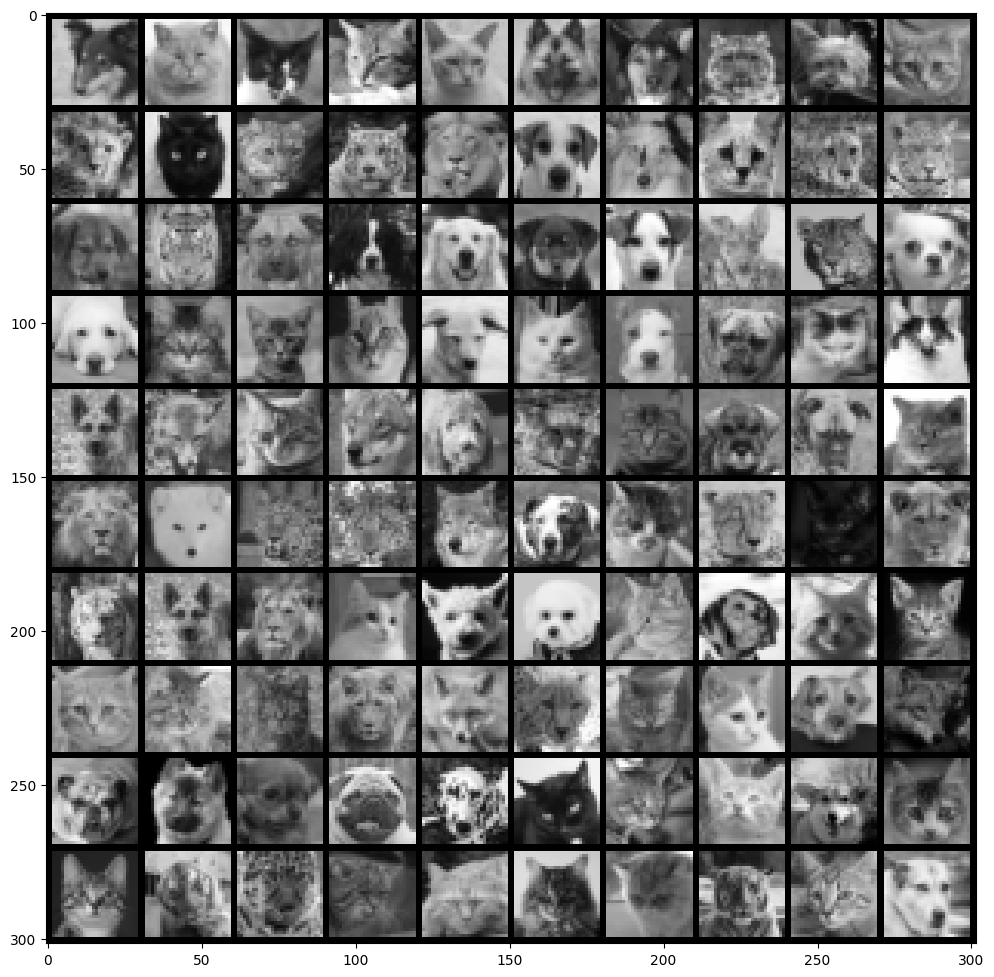

In [ ]:
images,labels = next(iter(train_loader))
plt.figure(figsize=(12,20))
img_grid = make_grid(images[0:100],nrow=10,padding=2)
plt.imshow(img_grid.permute(1,2,0))
data = images.squeeze()
data = torch.flatten(data,start_dim=1,end_dim=2)

# EM Model


- Sample from a M-faced die (M is the number of components in GMM) <br>
> $p_{\theta}(z)$ = $\alpha_{m}$ where m $\epsilon$ {1,2,...M} <br> <br>
- Sample x given z from $p_{\theta}(x|z)$ (Note that here we are imposing restrictions on $p_{\theta}(x|z)$ to follow normal distribution) <br>
> $p_{\theta}(x|z)$ = $N(x;\mu_{m},\Sigma_{m})$ <br>
- Derive $p_{\theta}(z|x)$ using Bayes rule <br>
> $p_{\theta}(z|x)$ = $\frac{p_{\theta}(x|z)*p_{\theta}(z)}{p_{\theta}(x)}$ <br>
> Here ${p_{\theta}(x)}$ = $\underset{m}{\sum}p_{\theta}(x|z)*p_{\theta}(z)$


# EM algorithm

- This algorithm contructs the lower bound of log likelihood of data
- Through Jensen's inequality, for concave function (logx)

$l^{\theta}(x)$ = $log\underset{q(z)}{E}(\frac{p_{\theta}(x,z)}{q(z)})$ $\geq$ $\underset{q(z)}{E}[log(\frac{p_{\theta}(x,z)}{q(z)})]$ = $F_{\theta}(q)$

## Expectation step

$q^{t+1}$ = $\underset{q}{argmax}F_{\theta^{t}}(q)$ <br>
This update is found to be $q^{t+1}$ = $p_{\theta^{t}}(z|x)$

##### ELBO <br>

> $F_{\theta}(q)$ = $\underset{q(z)}{E}[log(\frac{p_{\theta}(x,z)}{q(z)})]$<br> <br>
> $F_{\theta}(q)$ = $\underset{q(z)}{E}log(p_{\theta}(x,z))$ - $\underset{q_{\phi}(z)}{E}log(q(z))$ <br> <br>
> The right term of ELBo is independent of parameter $\theta$ and hence can be ignored <br> <br>
> $F_{\theta}(q)$ = $\underset{q(z)}{E}log(p_{\theta}(x|z)*p_{\theta}(z))$ <br> <br>
> $F_{\theta}(q)$ = $\underset{m}{\sum}[q(z)*log(p_{\theta}(x|z)*p_{\theta}(z))]$ <br> <br>
> As found in expectation step $q^{t+1}(z)$ = $p_{\theta^{t}}(z|x)$ maximizes the ELBo <br> <br>

## Maximization step

$\theta^{t+1}$ =  $\underset{\theta}{argmax}F_{\theta}(q^{t+1})$ <br>

> Substituting the q update found in Expectation step, the ELBo becomes: <br> <br>
> $F_{\theta}(q^{t+1})$ = $\underset{m}{\sum}[p_{\theta}(z|x)*log(p_{\theta}(x|z)*p_{\theta}(z))]$ <br> <br>
> Now we need to find new updates for $\mu_{m}^{t+1},\Sigma_{m}^{t+1},\alpha_{m}^{t+1}$ <br> <br>
> For this, we contruct a Lagrangian with the following optimization and constraint ($\underset{m}{\sum}\alpha_{m}=1$) <br> <br>
> $L(\alpha,\theta,\Sigma)$ = $F_{\theta}(q^{t+1})$ + $\lambda*(\underset{m}{\sum}\alpha_{m}-1)$ <br> <br>
> We differential the Langrangian with each of the parameters ($\mu_{m},\Sigma_{m},\alpha_{m}$) and equate to 0 --> KKT conditions

Consider: <br>
$\gamma_{ik}$ = $p_{\theta^{t}}(z_{k}|x_{i})$ <br> <br>
$N_{k}$ = $\sum_{i=1}^{n}\gamma_{ik}$ <br> <br>

This gives the following updates: <br> <br>
$\mu_{m}^{t+1}$ = $\frac{1}{N_{k}}\sum_{i=1}^{n}\gamma_{ik}*x_{i}$ <br> <br>
$\Sigma_{m}^{t+1}$ =  $\frac{1}{N_{k}}\sum_{i=1}^{n}(\gamma_{ik}*(x_{i}-\mu_{k})*(x_{i}-\mu_{k})^{T})$ <br> <br>
$\alpha_{m}^{t+1}$ = $\frac{\sum_{i=1}^{n}\gamma_{ik}}{N}$ where N is the number of samples






In [ ]:
class EM():
    def __init__(self):
        print('EM object created')


    def initialize_parameters(self,
                              data : torch.Tensor,
                              n_components : int):

        '''
        Initializes the GMM parameters : Mean, covariance, weights
        '''

        n_samples,data_len = list(data.size())

        indices = np.random.choice(n_samples, n_components, replace=False)
        means = data[indices]

        torch.manual_seed(1000)
        covariances = torch.rand((n_components,data_len,data_len),requires_grad=False)
        weights = torch.full([n_components], 1.0 / n_components,requires_grad=False)
        return means, covariances, weights

    def Expectation_step(self,
                         data : torch.Tensor,
                         weights : torch.Tensor,
                         n_components : int,
                         means : torch.Tensor,
                         covariances : torch.Tensor
                         ):
        '''
        Performs the expectation step to find the Evidence Lower Bound (ELBo) i.e. resp and also returns the log likelihood of the data
        '''
        n_samples, _ = list(data.size())
        log_resp = torch.zeros((n_samples, n_components))
        log_likelihood = 0
        covariances = torch.diag_embed(torch.diagonal(covariances,dim1=1,dim2=2))
        for i in range(n_samples):
            for k in range(n_components):
                log_resp[i, k] = torch.log(weights[k]) + self.log_gaussian(data[i,:],means[k,:],covariances[k,:,:])
            t = torch.logsumexp(log_resp[i,:],0)
            log_resp[i,:] -= t
            log_likelihood += t
        return torch.exp(log_resp),log_likelihood


    def Maximization_step(self,
                          data : torch.Tensor,
                          resp: torch.Tensor,
                          means: torch.Tensor
                          ):
        '''
        Performs the Maximization step to get updates for means, covariances and weights
        '''
        n_samples, _ = list(data.size())
        n_components = list(resp.size())[1]
        total_weight = torch.sum(resp, axis=0)
        new_means = torch.zeros(n_components,data.size()[1])
        covariances = torch.zeros(n_components,data.size()[1],data.size()[1])

        new_means = torch.matmul(resp.t(), data) / total_weight.unsqueeze(1)


        for k in range(n_components):
            cov = torch.zeros(data.size()[1],data.size()[1])
            for i in range(n_samples):
                diff = data[i,:] - means[k,:]
                covariances[k,:,:] += (resp[i, k]*(diff*diff.t()))/total_weight[k]

        weights = total_weight / n_samples
        return new_means, covariances, weights

    def log_gaussian(self,x,mean,cov):
        '''
        Getting log_likelihood for a Gaussian for a particular x, mean, covariance
        '''

        d = x.size()[0]
        cov_diag = torch.diagonal(cov)
        inv_cov_diag = torch.reciprocal(cov_diag)
        log_det = torch.sum(torch.log(cov_diag))
        log_2pi = d*np.log(2*np.pi)
        y = x - mean
        log_e = torch.sum(y*(y*inv_cov_diag))
        return -0.5*(log_2pi + log_det + log_e)


    def generate_samples(self,means, covariances, weights, n_samples):
        '''
        Generate samples from P(x|z) for a particular value of latent variable z
        '''

        n_components = means.shape[0]
        samples = np.zeros((n_samples, means.shape[1]))
        weights /= weights.sum()
        for i in range(n_samples):
            # Sample from a M-faced die
            component = np.random.randint(n_components,size=1)
            samples[i] = np.random.multivariate_normal(means[component[0]], covariances[component[0]])
        return samples

    def trainModel(self,iterations,components,means, covariances, weights):
        '''
        Runs the EM algorithm over batches and epochs and reports the updated mean, weight and covariances
        '''

        log_likelihood = []
        for epochs in range(iterations):
          total_likeli = 0
          for batch_index,(images,labels) in tqdm(enumerate(train_loader),total=len(train_loader),desc="EM Algorithm",colour="GREEN"):
            data = images.squeeze()
            data = torch.flatten(data,start_dim=1)
            resp,log_like = em.Expectation_step(data,weights,weights.size()[0],means,covariances)
            means, covariances, weights = em.Maximization_step(data,resp,means)
            total_likeli += log_like
            if torch.isinf(log_like.abs()) or torch.isnan(log_like.abs()):
              means, covariances, weights = em.initialize_parameters(data,n_components=components)
              total_likeli = 0

          log_likelihood.append(total_likeli)
          print(f'Epoch {epochs + 1}/{iterations} | log_likelihood = {total_likeli} | Weights : {weights}')

        return log_likelihood, means, covariances, weights

def plotLKlihood_IMG(components, log_likelihood,means, covariances, weights):

  '''
  Plots the log_likelihood of the data across epochs
  '''

  plt.title("Log Likelihood for " +str(components) + " Gaussian Mixtures")
  plt.xlabel("Epoch")
  plt.ylabel("Likelihood")
  plt.plot(log_likelihood)
  gen_sample = em.generate_samples(means,covariances,weights,n_samples=100)
  #print(gen_sample.shape)
  sample = gen_sample.reshape((100,1,28,28))
  samples_t = torch.tensor(sample)
  plt.figure(figsize=(12,20))
  img_grid = make_grid(samples_t,nrow=10,padding=2)
  plt.imshow(img_grid.permute(1,2,0))

em = EM()



EM object created


# EM Algorithm with different Hyperparameters


## Experiment 1.1:
- Number of components - 3
- Number of epochs - 10


## Observations
- Log Likelihood increases monotonically.
- Log likelihood saturates after 1st epoch.
- Generated images are relatively better when the number of Gaussian Components are increased. Same is the case with log likelihood values as well.

EM Algorithm: 100%|██████████| 17/17 [01:34<00:00,  5.54s/it]

Epoch 1/10 | log_likelihood = 1890762.5 | Weights : tensor([0.2633, 0.4173, 0.3194])



EM Algorithm: 100%|██████████| 17/17 [01:33<00:00,  5.53s/it]

Epoch 2/10 | log_likelihood = 2703592.25 | Weights : tensor([0.2526, 0.4001, 0.3473])



EM Algorithm: 100%|██████████| 17/17 [01:34<00:00,  5.58s/it]

Epoch 3/10 | log_likelihood = 2706509.0 | Weights : tensor([0.2791, 0.3784, 0.3425])



EM Algorithm: 100%|██████████| 17/17 [01:34<00:00,  5.58s/it]

Epoch 4/10 | log_likelihood = 2723096.0 | Weights : tensor([0.2684, 0.3047, 0.4268])



EM Algorithm: 100%|██████████| 17/17 [01:34<00:00,  5.56s/it]

Epoch 5/10 | log_likelihood = 2726351.5 | Weights : tensor([0.3024, 0.3977, 0.2999])



EM Algorithm: 100%|██████████| 17/17 [01:33<00:00,  5.49s/it]

Epoch 6/10 | log_likelihood = 2722388.0 | Weights : tensor([0.2347, 0.4284, 0.3368])



EM Algorithm: 100%|██████████| 17/17 [01:35<00:00,  5.59s/it]

Epoch 7/10 | log_likelihood = 2724047.25 | Weights : tensor([0.2576, 0.3856, 0.3568])



EM Algorithm: 100%|██████████| 17/17 [01:34<00:00,  5.58s/it]

Epoch 8/10 | log_likelihood = 2727347.5 | Weights : tensor([0.2911, 0.3158, 0.3930])



EM Algorithm: 100%|██████████| 17/17 [01:35<00:00,  5.61s/it]

Epoch 9/10 | log_likelihood = 2727261.5 | Weights : tensor([0.2213, 0.3736, 0.4051])



EM Algorithm: 100%|██████████| 17/17 [01:34<00:00,  5.54s/it]


Epoch 10/10 | log_likelihood = 2720293.75 | Weights : tensor([0.2810, 0.3098, 0.4092])


<ipython-input-23-21b390adf5f1>:87: RuntimeWarning: covariance is not positive-semidefinite.
  samples[i] = np.random.multivariate_normal(means[component[0]], covariances[component[0]])


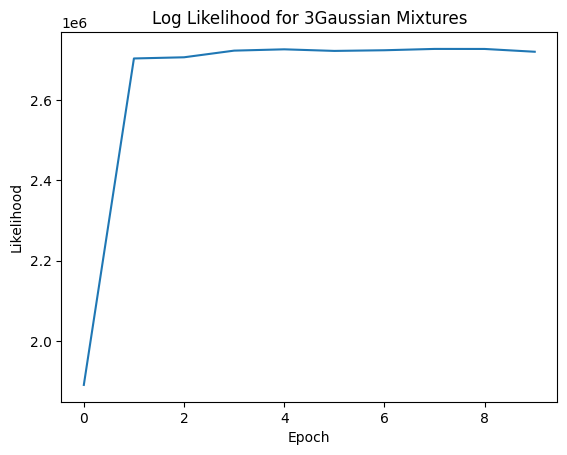

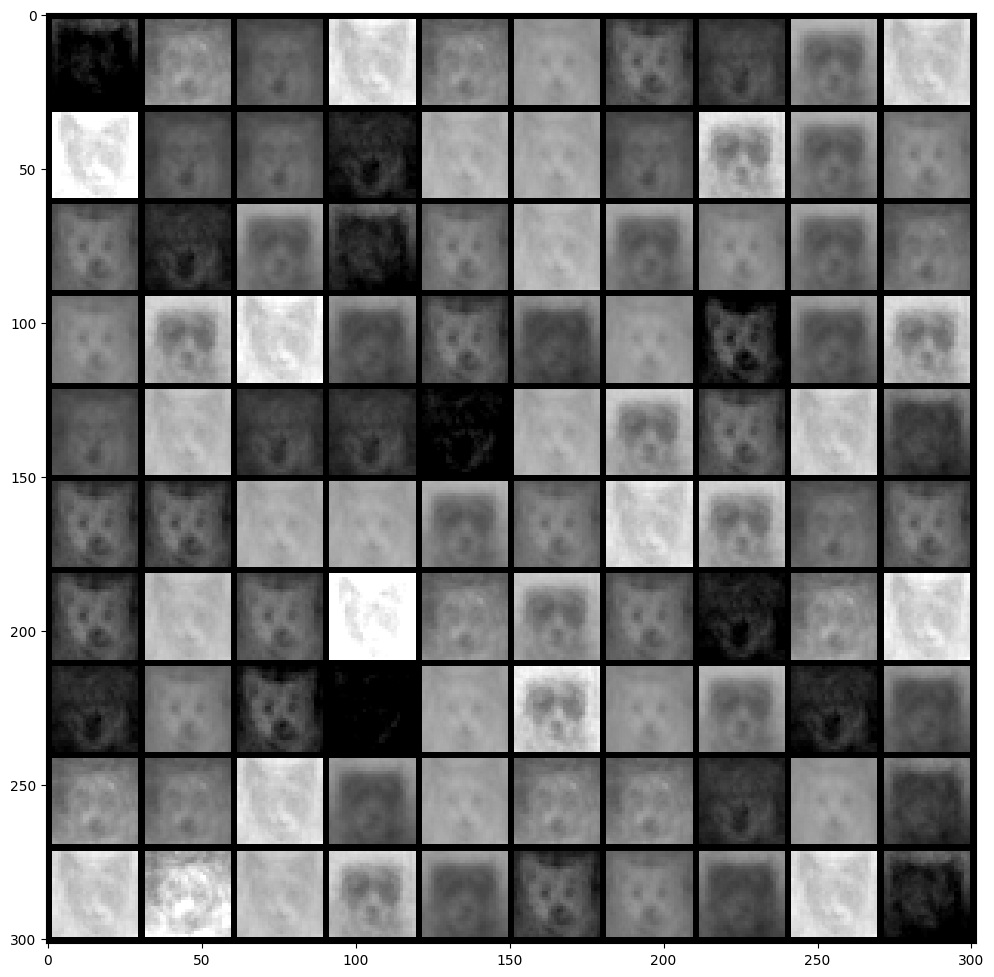

In [ ]:
components = 3
iterations = 10
means, covariances, weights = em.initialize_parameters(data,n_components=components)

log_likelihood, means, covariances, weights = em.trainModel(iterations,components,means, covariances, weights)
plotLKlihood_IMG(components, log_likelihood, means, covariances, weights)

**Experiment 1.2:**
- Number of components - 5
- Number of epochs - 5

EM Algorithm: 100%|██████████| 17/17 [01:54<00:00,  6.76s/it]

Epoch 1/5 | log_likelihood = 1735412.0 | Weights : tensor([0.2222, 0.1467, 0.2105, 0.2414, 0.1792])



EM Algorithm: 100%|██████████| 17/17 [01:52<00:00,  6.63s/it]

Epoch 2/5 | log_likelihood = 3286158.0 | Weights : tensor([0.2225, 0.1589, 0.1902, 0.2432, 0.1852])



EM Algorithm: 100%|██████████| 17/17 [01:54<00:00,  6.74s/it]

Epoch 3/5 | log_likelihood = 3284946.5 | Weights : tensor([0.1560, 0.1682, 0.2282, 0.1783, 0.2693])



EM Algorithm: 100%|██████████| 17/17 [01:53<00:00,  6.65s/it]

Epoch 4/5 | log_likelihood = 3281436.75 | Weights : tensor([0.2060, 0.2166, 0.1836, 0.1938, 0.2000])



EM Algorithm: 100%|██████████| 17/17 [01:50<00:00,  6.48s/it]


Epoch 5/5 | log_likelihood = 3278391.0 | Weights : tensor([0.2060, 0.1863, 0.2006, 0.2073, 0.1999])


<ipython-input-23-21b390adf5f1>:87: RuntimeWarning: covariance is not positive-semidefinite.
  samples[i] = np.random.multivariate_normal(means[component[0]], covariances[component[0]])


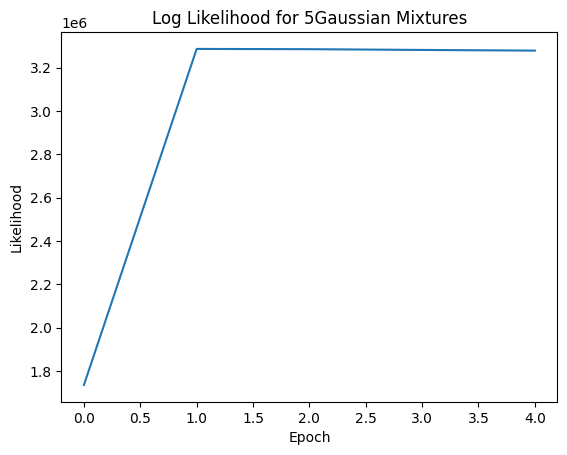

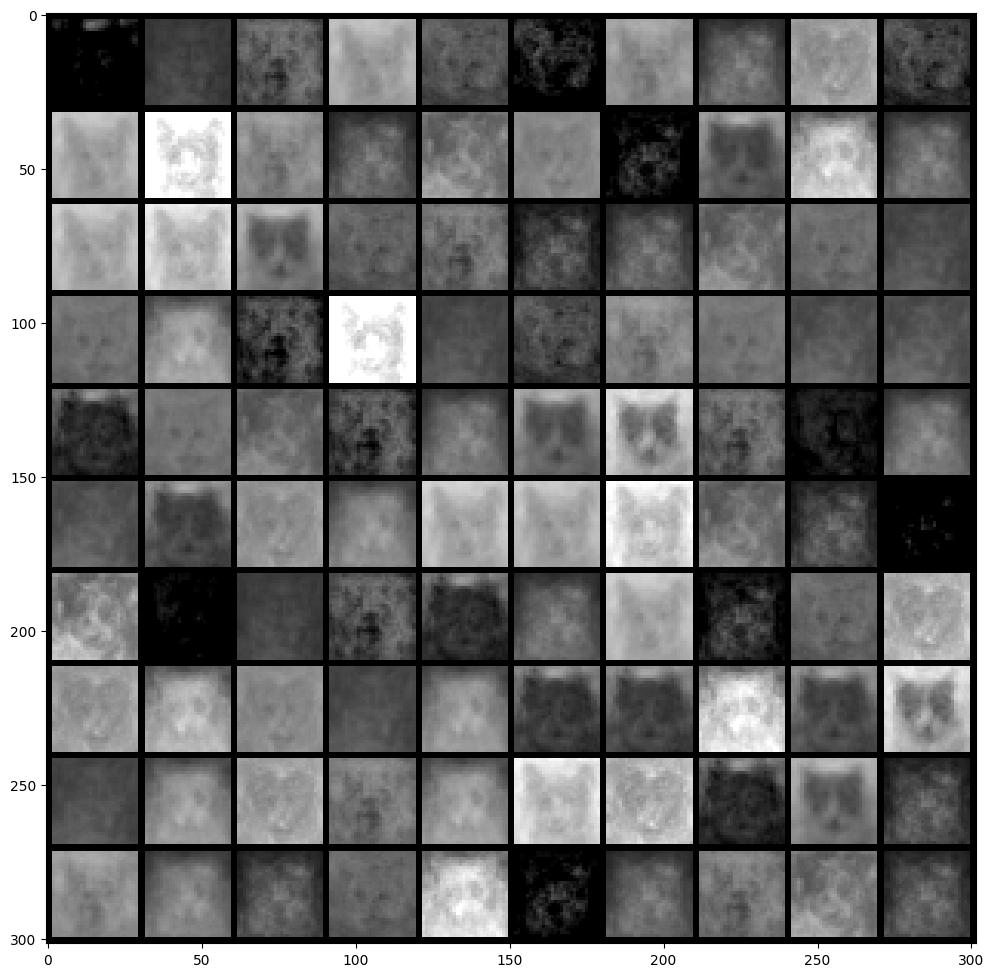

In [ ]:
components = 5
iterations = 5
means, covariances, weights = em.initialize_parameters(data,n_components=components)

log_likelihood, means, covariances, weights = em.trainModel(iterations,components,means, covariances, weights)
plotLKlihood_IMG(components, log_likelihood, means, covariances, weights)

**Experiment 1.3:**
- Number of components - 5
- Number of epochs - 5

EM Algorithm: 100%|██████████| 17/17 [02:05<00:00,  7.41s/it]

Epoch 1/5 | log_likelihood = 1182128.25 | Weights : tensor([0.1579, 0.1158, 0.1264, 0.1106, 0.2003, 0.1579, 0.1311])



EM Algorithm: 100%|██████████| 17/17 [02:01<00:00,  7.18s/it]

Epoch 2/5 | log_likelihood = 3565086.75 | Weights : tensor([0.1421, 0.1368, 0.1421, 0.1010, 0.1869, 0.1490, 0.1420])



EM Algorithm: 100%|██████████| 17/17 [02:02<00:00,  7.21s/it]

Epoch 3/5 | log_likelihood = 3577942.5 | Weights : tensor([0.1511, 0.1273, 0.1497, 0.1798, 0.1737, 0.0816, 0.1368])



EM Algorithm: 100%|██████████| 17/17 [02:02<00:00,  7.21s/it]

Epoch 4/5 | log_likelihood = 3586657.0 | Weights : tensor([0.1316, 0.1421, 0.1526, 0.1526, 0.1842, 0.1158, 0.1210])



EM Algorithm: 100%|██████████| 17/17 [02:03<00:00,  7.25s/it]


Epoch 5/5 | log_likelihood = 3591516.75 | Weights : tensor([0.1211, 0.1473, 0.1368, 0.1580, 0.1684, 0.0947, 0.1737])


<ipython-input-23-21b390adf5f1>:87: RuntimeWarning: covariance is not positive-semidefinite.
  samples[i] = np.random.multivariate_normal(means[component[0]], covariances[component[0]])


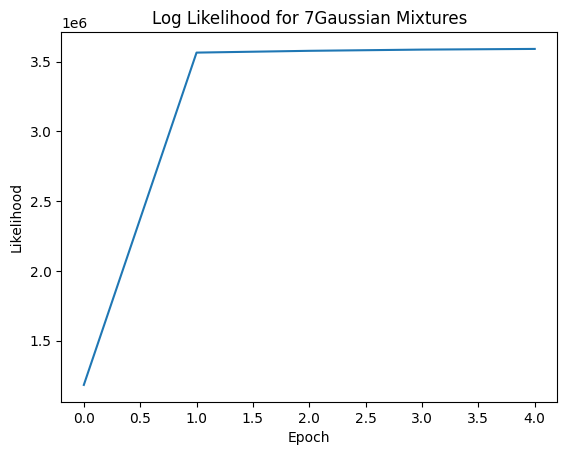

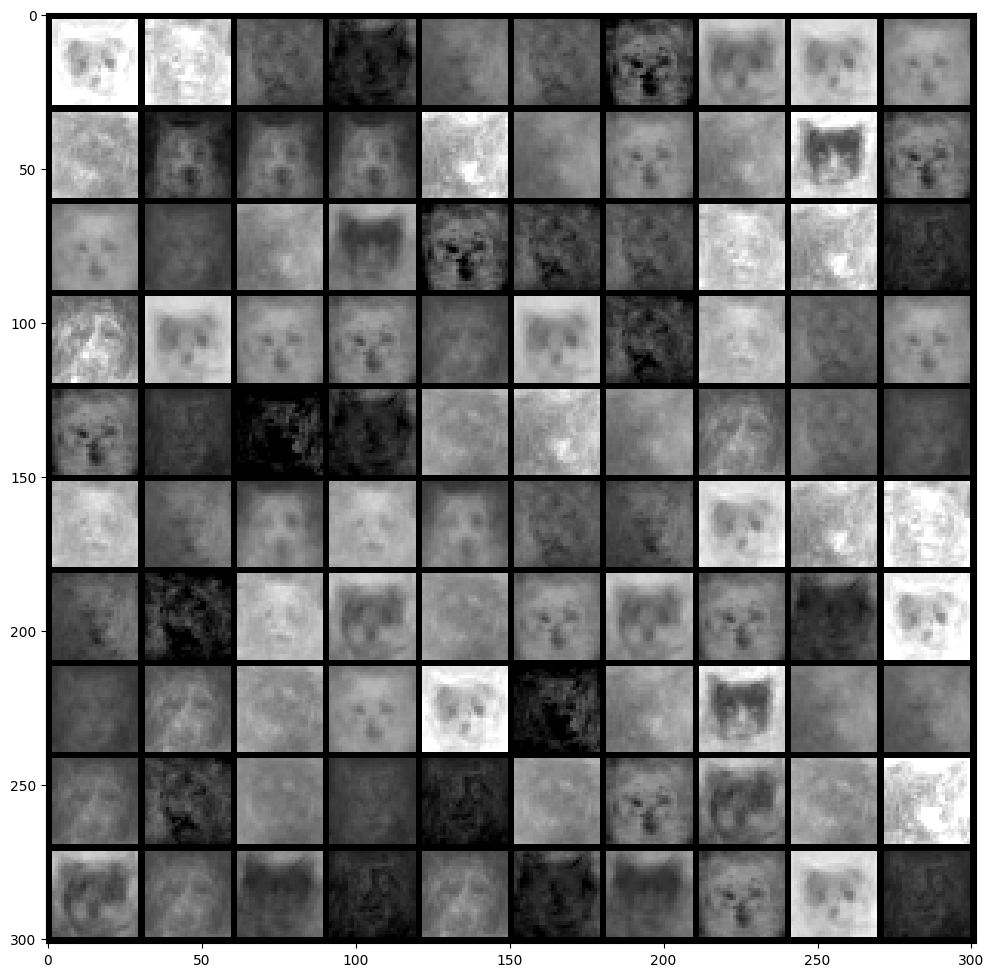

In [ ]:
components = 7
iterations = 5
means, covariances, weights = em.initialize_parameters(data,n_components=components)

log_likelihood, means, covariances, weights = em.trainModel(iterations,components,means, covariances, weights)
plotLKlihood_IMG(components, log_likelihood, means, covariances, weights)

# Experiment 1.4: EM on higher dimension data - RGB

## Objective:

- Compare the perform of the GMM with higher dimensional data.

## Observations:

- The generated images do not appear to have any color even though the training images were RBG images. This indicates loss information while generation. This shows that GMM ill performs with higher dimensional data.

- EM algorithm generates singular covariance matrices with incrasing dimensions which leads to convergence issues.

- Training time significantly increased with higher dimensions.

In [ ]:
# Update data_path based on your data location before running the cell

'''
Downsize the dataset to 3*28*28
'''

transform = transforms.Compose(
    [
        transforms.Resize(28),
        transforms.ToTensor()
    ]

)
data_path = "/content/drive/MyDrive/archive/afhq"

train_data = datasets.ImageFolder(root=data_path,transform=transform)
batch_size = 1000
train_loader = DataLoader(train_data,batch_size=batch_size,shuffle=True,num_workers=2)

images,labels = next(iter(train_loader))
print(images.shape)
plt.figure(figsize=(12,20))
img_grid = make_grid(images[0:100],nrow=10,padding=2)
plt.imshow(img_grid.permute(1,2,0))
data = images.squeeze()
#print(data.shape)
data = torch.flatten(data,start_dim=1)

In [ ]:
components = 3
iterations = 5
means, covariances, weights = em.initialize_parameters(data,n_components=components)

log_likelihood = []
for epochs in range(iterations):
    total_likeli = 0
    for batch_index,(images,labels) in tqdm(enumerate(train_loader),total=len(train_loader),desc="EM Algorithm",colour="GREEN"):
        data = images.squeeze()
        data = torch.flatten(data,start_dim=1)
        resp,log_like = em.Expectation_step(data,weights,weights.size()[0],means,covariances)
        means, covariances, weights = em.Maximization_step(data,resp,means)
        total_likeli += log_like

        #print(log_like)
        if torch.isinf(log_like.abs()) or torch.isnan(log_like.abs()):
            means, covariances, weights = em.initialize_parameters(data,n_components=components)
            total_likeli = 0

    log_likelihood.append(total_likeli)
    print(f'Epoch {epochs + 1}/{iterations} | log_likelihood = {total_likeli} | Weights : {weights}')


[1000, 2352]
1000
2352


EM Algorithm: 100%|██████████| 17/17 [03:16<00:00, 11.54s/it]

Epoch 1/5 | log_likelihood = 4459322.5 | Weights : tensor([0.2685, 0.4260, 0.3055])



EM Algorithm: 100%|██████████| 17/17 [03:23<00:00, 11.95s/it]

Epoch 2/5 | log_likelihood = 6849374.0 | Weights : tensor([0.3423, 0.3335, 0.3242])



EM Algorithm: 100%|██████████| 17/17 [03:25<00:00, 12.09s/it]

Epoch 3/5 | log_likelihood = 6862313.5 | Weights : tensor([0.4303, 0.3163, 0.2534])



EM Algorithm: 100%|██████████| 17/17 [03:22<00:00, 11.91s/it]

Epoch 4/5 | log_likelihood = 6853665.0 | Weights : tensor([0.4053, 0.3948, 0.2000])



EM Algorithm: 100%|██████████| 17/17 [03:23<00:00, 11.96s/it]

Epoch 5/5 | log_likelihood = 6870102.0 | Weights : tensor([0.3737, 0.3613, 0.2650])


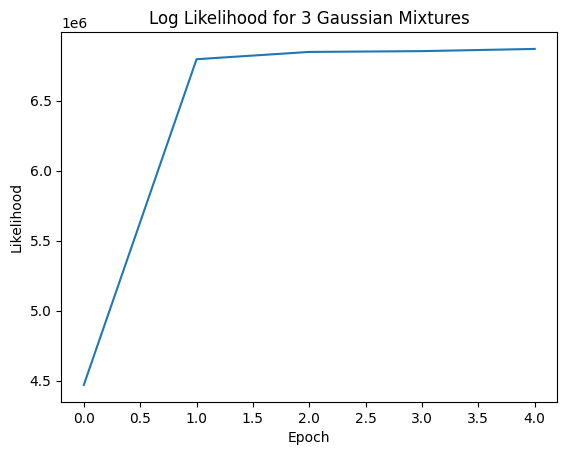

In [ ]:
plt.title("Log Likelihood for " +str(components) + " Gaussian Mixtures")
plt.xlabel("Epoch")
plt.ylabel("Likelihood")
plt.plot(log_likelihood)

<ipython-input-29-6cb3ebb25db2>:87: RuntimeWarning: covariance is not positive-semidefinite.
  samples[i] = np.random.multivariate_normal(means[component[0]], covariances[component[0]])


(100, 2352)


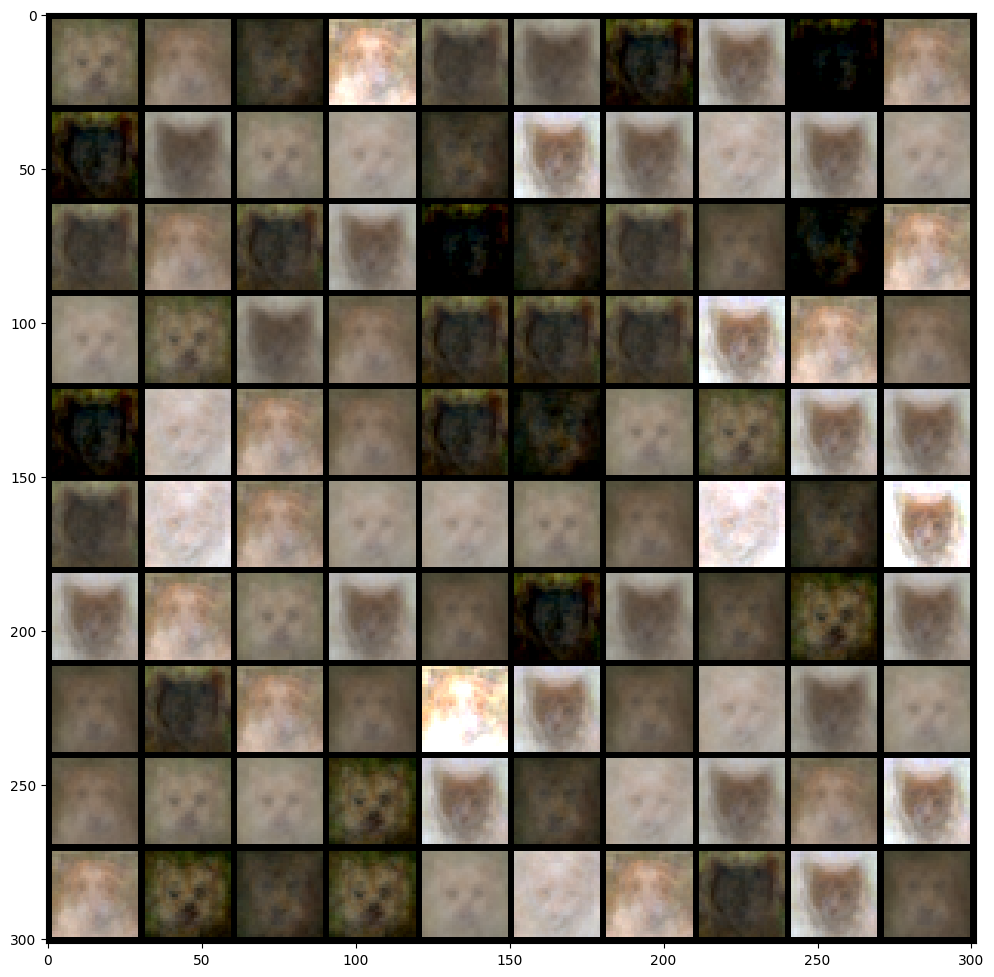

In [ ]:
gen_sample = em.generate_samples(means,covariances,weights,n_samples=100)
print(gen_sample.shape)
sample = gen_sample.reshape((100,3,28,28))
samples_t = torch.tensor(sample)
plt.figure(figsize=(12,20))
img_grid = make_grid(samples_t,nrow=10,padding=2)
plt.imshow(img_grid.permute(1,2,0))

# Problem2 - Vanilla VAE

- Vanilla VAE model is implemented on Pytorch
- Kaggle dataset for animal images used (Dataset has 16130 images of cats, dogs and wild animals)
- Note: The training and validation dataset are combined here since we are not running any posterior inferencing on X_test samples
- Objective:
    - Implement a vanilla VAE with MSE for conditional likeli-hood
    - Plot 10 by 10 grids of both reconstructions and generations
    - Plot the loss curves for likelihood, KL, and the combined terms


## Import required Python libraries

In [ ]:
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam
import matplotlib.pyplot as plt
from torch.distributions import MultivariateNormal
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from mpl_toolkits.axes_grid1 import ImageGrid
from torchvision.utils import save_image, make_grid
import matplotlib.pyplot as plt
from torchvision import datasets
from tqdm import tqdm

## Mount the drive in Google collab

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Unzip the data in Google Collab

In [ ]:
!unzip "/content/drive/MyDrive/ADRL Assignment/data.zip" -d "/content/drive/MyDrive/ADRL Assignment/"

## Loading data from the folders

- Compose a transform with:
    - Images resized to (3,128,128)
    - Convert images to Torch tensor
<br>
<br>        
        
- Load the images from the folder with a batch size of 100

In [ ]:
transform = transforms.Compose(
    [
        transforms.Resize(size=128),
        transforms.ToTensor()
    ]

)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#train_data = datasets.ImageFolder('/content/drive/MyDrive/ADRL Assignment/data/',transform=transform)
train_data = datasets.ImageFolder('.\\archive\\afhq\\',transform=transform)
batch_size = 100
train_loader = DataLoader(train_data,batch_size=batch_size,shuffle=True,num_workers=4)

## Samples image grid

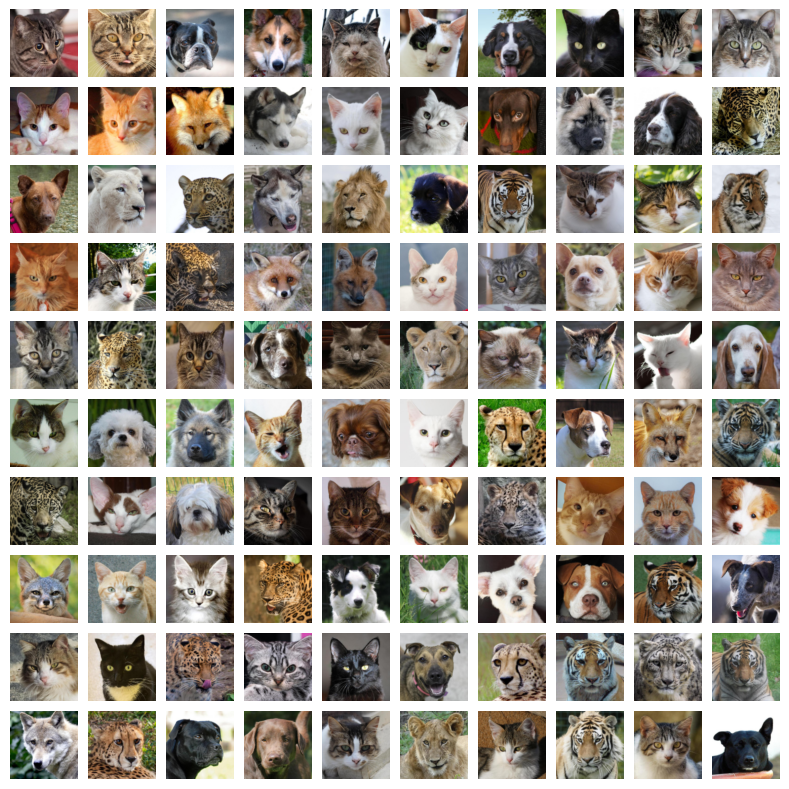

In [ ]:
image,_ = next(iter(train_loader))


num_samples = 100
sample_images = image.permute(0,2,3,1)[0:num_samples]

fig = plt.figure(figsize=(10, 10))
grid = ImageGrid(fig, 111, nrows_ncols=(10, 10), axes_pad=0.1)

for ax, im in zip(grid, sample_images):
    ax.imshow(im)
    ax.axis('off')

plt.show()

## VAE Model

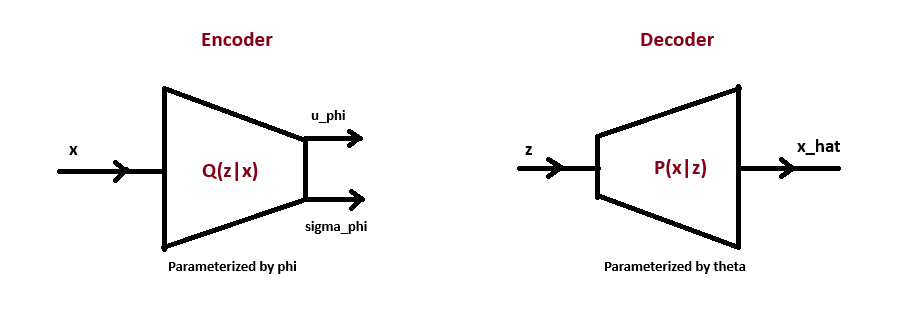

### Model

Input data: x $\sim$ $P_{x}$ ; x $\epsilon$ $R^{d}$<br>
Output data: $\hat{x}$ $\sim$ $P_{\theta}(x|z)$ ; $\hat{x}$ $\epsilon$ $R^{d}$<br> <br>

Encoder input: <br>
> x $\sim$ $P_{x}$ where $P_{x}$ is the True Data Distribution <br>
<br>

Encoder outputs: <br>
> $\mu_{\phi}$ $\epsilon$ $R^{k}$ <br>
> $\Sigma_{\phi}$ $\epsilon$ $R^{k}$ <br>
> Where k is the latent dimension (k = 128 in the model below) <br>
> Note: Here $\Sigma_{\phi}$ is assumed to be a Diagonal Covariance <br>
> Modelling choice of encoder: $Q_{\phi}(z|x)$ $\sim$ $N(x;\mu_{\phi},\Sigma_{\phi})$
<br>

Decoder input: <br>
> z = $\mu_{\phi}$ + $\Sigma_{\phi}\odot\epsilon$ through reparameterization <br>
> Where $\epsilon$ $\sim$ N(0,1) <br>
> Modelling choice for generators input: $P_{\theta}(z)$ $\sim$ $N(z;0,I)$
<br>

Decoder output: <br>
> $\hat{x}$ $\sim$ $P_{\theta}(x|z)$ <br>
> Modelling choice: $P_{\theta}(x|z)$ $\sim$ $N(x;\hat{x},I)$

### Loss Function

#### Objective: ELBo maximization <br>

> ELBo = $\underset{Q_{\phi}(z|x)}{E}logp_{\theta}(x|z)\:-\:D_{KL}(q_{\phi}(z|x)||p_{\theta}(z))$ <br> <br>

#### Reconstruction Loss: <br>
> Reconstruction loss: $\underset{Q_{\phi}(z|x)}{E}log(p_{\theta}(x|z))$ = $-\frac{1}{L}||x\:-\:\hat{x}||_{2}^{2}$ <br>
> L: number of instances of z input to the decoder <br> <br>
> Note: The division by L is when only 1 instance of x is input to the encoder and trained (i.e. only one $\mu_{\phi}$ and $\Sigma_{\phi}$) <br> <br>
> For the case when a batch of x is provided to the encoder, the Reconstruction loss becomes: $-\frac{1}{M}||x\:-\:\hat{x}||_{2}^{2}$ <br>
> where M = N * L ; N : batch size <br> <br>
> Note: <br>
> For $P_{\theta}(x|z)$ $\sim$ $N(x;\hat{x},I)$ , the Reconstruction loss takes MSE loss structure (i.e. Norm) <br>
> For $P_{\theta}(x|z)$ $\sim$ Bernoulli distribution, the Reconstruction loss takes Binary Cross Entropy loss structure <br>

#### KLD Loss: <br>
> $D_{KL}(q_{\phi}(z|x)||p_{\theta}(z))$ = $\frac{1}{2}[\mu_{\phi}^{T}\mu_{\phi}\:+\:tr(\Sigma_{\phi})\:-\:k\:-\:log|\Sigma_{\phi}|]$ <br> <br>
> $D_{KL}(q_{\phi}(z|x)||p_{\theta}(z))$ = $-\frac{1}{2}[\underset{i}{\sum}(log\sigma_{i}^{2}\:+\:1)\:-\:\underset{i}{\sum}\sigma_{i}^{2}\:-\:\underset{i}{\sum}\mu_{i}^{2}]$ <br>
> For the KLD Loss in the model below, the mean of this value is taken across M as the KLD loss is for each $\mu_{\phi}$ and $\Sigma_{\phi}$ <br>

#### Total Loss: <br>
> L($\theta$, $\phi$) = $\underset{\theta,\phi}{\max}$ (Reconstruction Loss - $\beta$*KLD Loss) = $\underset{\theta,\phi}{\min}$ (-Reconstruction Loss + $\beta$*KLD Loss)<br> <br>
> $\beta$ = 1 for Vanilla VAE (For Beta-VAE experiments, the beta is varied and observations are documented) <br>
> Pytorch implements loss minimization


### Generator Function

> During training, the $Q_{\phi}(z|x)$ distribution has been made to follow $P_{\theta}(z)$ through the minimization of KLD Loss term <br>
> For Generation now, we can sample from $P_{\theta}(z)$ $\sim$ $N(z;0,I)$ and input to Decoder <br>


### Hyper-parameters for Training

> k : Latent dimension <br>
> L : Number of instances of z input to the decoder <br>
> Learning rate: {1e-3, 1e-4} <br>


### Model Parameters

> k : 128 <br>
> Batch size : 100 (sometimes 10 used when L value was more than 1 to reduce compute complexity) <br>
> Input image dimensions: (3,128,128) <br>
> Output image dimensions: (3,128,128) <br>
> Optimizer used: Adam <br>
> Number of epochs: 20 <br>
> Data size: 16130 images (Combined the train and val data as no posterior inference on X_test to be done)

In [ ]:
class VAE(nn.Module):

    def __init__(self,Encoder_sel ,Decoder_sel, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device):
        super(VAE, self).__init__()

        # Encoder and Decoder Selection variables
        self.Encoder_sel = Encoder_sel
        self.Decoder_sel = Decoder_sel

        # Building the FCN Encoder
        if(self.Encoder_sel == 1):
            self.encoder = nn.Sequential(
                nn.Flatten(1,3),
                nn.Linear(input_dim, hidden_dim_1),
                nn.LeakyReLU(0.2),
                nn.Linear(hidden_dim_1, hidden_dim_2),
                nn.LeakyReLU(0.2)
                )
        elif(self.Encoder_sel == 2):    # Building the CNN Encoder
            self.encoder = nn.Sequential(
                nn.Conv2d(3,16,3),      # Output feature dim: 126*126*16
                nn.ReLU(),
                nn.MaxPool2d(2),        # Output feature dim: 63*63*16
                nn.Conv2d(16,32,4),     # Output feature dim: 60*60*32
                nn.ReLU(),
                nn.MaxPool2d(2),        # Output feature dim: 30*30*32
                nn.Flatten(1,3),
                nn.Linear(30*30*32, hidden_dim_1),
                nn.ReLU(),
                nn.Linear(hidden_dim_1, hidden_dim_2),
                nn.ReLU(),
                )

        # Get the Latent Mean and Variance
        self.mean_layer = nn.Linear(hidden_dim_2, latent_dim)
        self.logvar_layer = nn.Linear(hidden_dim_2, latent_dim)

        # Building the FCN Decoder
        if(self.Decoder_sel == 1):
            # FCN
            self.decoder = nn.Sequential(
                nn.Linear(latent_dim, hidden_dim_2),
                nn.LeakyReLU(0.2),
                nn.Linear(hidden_dim_2, hidden_dim_1),
                nn.LeakyReLU(0.2),
                nn.Linear(hidden_dim_1, input_dim),
                nn.Sigmoid(),
                nn.Unflatten(1,(3,128,128))
                )
        elif(self.Decoder_sel == 2): # Building the CNN Decoder 1
            # Our Best model
            self.decoder = nn.Sequential(
                nn.Linear(latent_dim, hidden_dim_2),
                nn.LeakyReLU(0.2),
                nn.Linear(hidden_dim_2, hidden_dim_1),
                nn.LeakyReLU(0.2),
                nn.Linear(hidden_dim_1, input_dim),
                nn.LeakyReLU(0.2),
                nn.Unflatten(1,(12,64,64)),
                nn.ConvTranspose2d(12,24,kernel_size=2,stride=2), # Output feature dim: 128*128*24
                nn.LeakyReLU(0.2),
                nn.Conv2d(24,24,kernel_size=3,padding=1),         # Output feature dim: 128*128*24
                nn.LeakyReLU(0.2),
                nn.MaxPool2d(2),                                  # Output feature dim: 64*64*24
                nn.ConvTranspose2d(24,12,kernel_size=2,stride=2), # Output feature dim: 128*128*12
                nn.LeakyReLU(0.2),
                nn.Conv2d(12,3,kernel_size=3,padding=1),          # Output feature dim: 128*128*3
                nn.Sigmoid()
                )
        elif(self.Decoder_sel == 3):
            # Building the CNN Decoder 2
            self.decoder = nn.Sequential(
                nn.Linear(latent_dim, hidden_dim_2),
                nn.LeakyReLU(0.2),
                nn.Linear(hidden_dim_2, hidden_dim_1),
                nn.LeakyReLU(0.2),
                nn.Linear(hidden_dim_1, input_dim),
                nn.LeakyReLU(0.2),
                nn.Unflatten(1,(3,128,128)),
                nn.Conv2d(3,6,kernel_size=3,padding=1),           # Output feature dim: 128*128*6
                nn.LeakyReLU(0.2),
                nn.MaxPool2d(2),                                  # Output feature dim: 64*64*6
                nn.ConvTranspose2d(6,16,kernel_size=2,stride=2),  # Output feature dim: 128*128*16
                nn.LeakyReLU(0.2),
                nn.Conv2d(16,3,kernel_size=3,padding=1),          # Output feature dim: 128*128*3
                nn.Sigmoid()
                )

    def encode(self, x):
        """
        Function to pass through Encoder and output mean and variance
        """
        x = self.encoder(x)
        mean, logvar = self.mean_layer(x), self.logvar_layer(x)
        return mean, logvar

    def reparameterization(self, mean, var):
        """
        Function to apply Reparameterization trick
        """
        eps_diag = torch.randn(len(var)).to(device)
        eps = torch.diag(eps_diag).to(device)
        z = mean + torch.matmul(eps,var)
        z = z.to(device)
        return z

    def decode(self, x):
        """
        Function to pass through Decoder
        """
        return self.decoder(x)


    def forward(self, x, num_z):
        """
        Function to take input through a forward pass of the model.
        """
        mean, log_var = self.encode(x)
        mean = mean.repeat_interleave(num_z,dim=0)
        log_var = log_var.repeat_interleave(num_z,dim=0)
        z = self.reparameterization(mean, torch.exp(0.5 * log_var))
        x_hat = self.decode(z)
        return x_hat, mean, log_var


def loss_function(x, x_hat, mean, log_var, num_z, loss_type, reduction_type = 'sum' , beta=1):
    """
    Function to define the VAE Loss Function. This also includes beta which is set to 1 for VAE.
    """
    x = x.repeat_interleave(num_z,dim=0)
    if(loss_type == 'BCE'):
        if(reduction_type == 'sum'):
            reproduction_loss = F.binary_cross_entropy(x_hat, x,reduction=reduction_type)/len(x)
        elif(reduction_type == 'mean'):
            reproduction_loss = F.binary_cross_entropy(x_hat, x, reduction=reduction_type)
    elif(loss_type == 'MSE'):
        if(reduction_type == 'sum'):
            reproduction_loss = F.mse_loss(x_hat, x,reduction=reduction_type)/len(x)
        elif(reduction_type == 'mean'):
            reproduction_loss = F.mse_loss(x_hat, x,reduction=reduction_type)

    KLD = torch.mean(-0.5 * torch.sum(1+ log_var - mean.pow(2) - log_var.exp(),dim=1),dim=0)
    return (reproduction_loss + (beta * KLD)),reproduction_loss,KLD



def train(model, optimizer, epochs, device, loss_type, reduction_type, num_z, beta):
    """
    Function to run the training loop.
    """
    model.train()
    Reconst_loss_list = []
    KLD_loss_list = []
    for epoch in range(epochs):
        for batch_idx, (x, _) in tqdm(enumerate(train_loader),total=len(train_loader),desc="VAE",colour="GREEN"):
            x = x.to(device)
            #Forward pass
            x_hat, mean, log_var = model(x,num_z = num_z)
            x = torch.flatten(x,start_dim=1,end_dim=3)
            x_hat = torch.flatten(x_hat,start_dim=1,end_dim=3)

            #Loss function
            loss,R_loss,KLD_loss = loss_function(x, x_hat, mean, log_var,num_z=num_z, loss_type=loss_type, reduction_type = reduction_type, beta=beta)

            #Backward pass
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        print(f"\tEpoch: {epoch + 1}/{epochs} | Rec Loss: {R_loss:.6f} | KLD_loss: {KLD_loss:.6f} | Total loss: {loss:.6f}")

        # Saving loss terms for plotting.
        Reconst_loss_list.append(R_loss)
        KLD_loss_list.append(KLD_loss)
    return Reconst_loss_list,KLD_loss_list


def generate_image(n_samples, model, z_val, x = [], plot_reconstruction = False, num_z = 1):
    """
    Function to generate images on a 10x10 grid
    """
    x_decoded = torch.zeros((n_samples,3,128,128)).to(device)
    z_val = z_val.to(device)

    x_decoded = model.decode(z_val)

    x_decoded = x_decoded.detach().cpu().reshape(n_samples,3, 128, 128) # reshape vector to 2d array

    fig = plt.figure(figsize=(10, 10))
    grid = ImageGrid(fig, 111, nrows_ncols=(10, 10), axes_pad=0.1)


    for ax, im in zip(grid, x_decoded):
        ax.imshow(im.permute(1,2,0))
        ax.axis('off')

    fig.suptitle('Generated Images (10x10) - Sampling latent space and passing through Decoder')
    plt.show()

    # Plot reconstructed images only if necessary
    if(plot_reconstruction):
        x = x.to(device)
        x_hat,_,_ = model.forward(x,num_z)
        x_hat = x_hat.detach().cpu().reshape(n_samples,3, 128, 128)
        fig2 = plt.figure(figsize=(10, 10))
        grid2 = ImageGrid(fig2, 111, nrows_ncols=(10, 10), axes_pad=0.1)


        for ax, im in zip(grid2, x_hat):
            ax.imshow(im.permute(1,2,0))
            ax.axis('off')

        fig2.suptitle('Reconstructed Images (10x10) - Forward pass of the model')
        plt.show()

def plot_grid(model, latent_dim = 128, num_samples = 100, x = [], plot_reconstruction = False, num_z = 1):
    """
    Function to generate z and create images through the model.
    """
    p_z = MultivariateNormal(torch.zeros(latent_dim), torch.eye(latent_dim))
    z_val = p_z.sample((num_samples,))
    generate_image(num_samples, model, z_val, x , plot_reconstruction, num_z)

def plot_loss(Reconst_loss_list, KLD_loss_list):
    """
    Function to plot the Reconstruciton, KLD, and Total loss graphs.
    """
    KLD_loss_list = np.hstack([i.detach().cpu().numpy() for i in KLD_loss_list])
    Reconst_loss_list = np.hstack([i.detach().cpu().numpy() for i in Reconst_loss_list])

    Total_loss = np.array(Reconst_loss_list) + np.array(KLD_loss_list)
    fig,ax = plt.subplots(3,figsize=(8,8))
    len_ = len(Reconst_loss_list)

    ax[0].plot(np.linspace(1,len_,len_),Reconst_loss_list)
    ax[0].set_xlabel('Epochs')
    ax[0].set_ylabel('Recontruction Loss')
    ax[0].set_title('Recontruction Loss vs Epochs')
    ax[0].set_xticks(np.linspace(1,len_,len_))
    ax[0].grid()

    ax[1].plot(np.linspace(1,len_,len_),KLD_loss_list)
    ax[1].set_xlabel('Epochs')
    ax[1].set_ylabel('KLD Loss')
    ax[1].set_title('KLD Loss vs Epochs')
    ax[1].set_xticks(np.linspace(1,len_,len_))
    ax[1].grid()

    ax[2].plot(np.linspace(1,len_,len_),Total_loss)
    ax[2].set_xlabel('Epochs')
    ax[2].set_ylabel('Total Loss')
    ax[2].set_title('Total Loss vs Epochs')
    ax[2].set_xticks(np.linspace(1,len_,len_))
    ax[2].grid()

    fig.suptitle('Losses vs Epoch')
    plt.tight_layout(rect=[0, 0, 1, 0.95])


## $Experiments$

### Exp Group 1: Test different implementations of Encoder and Decoder

- Exp 1.1: Encoder is a CNN, Decoder is a CNN
- Exp 1.2: Encoder is a FCN, Decoder is a CNN
- Exp 1.3: Encoder is a CNN, Decoder is a FCN

#### Observations

- Exp 1.1 performs better than the other models as CNN is better able to retain the spatial information
    - As a result the faces of animals are more clearer or natural
    - On the other hand the FCN, although it could bring better colors, didnt retain the spatial information
- Losses in all 3 models doesn't seem to be monotically decreasing across epochs but overall the losses decrease across the epochs.
    - The total loss in Exp1.1 seems to be slightly higher than other experiments (Could be more optimized by running more Epochs)
    - KLD loss is much smaller than the Reconstruction loss. Implies that $q_{\phi}(z|x)$ was able to follow $p_{\theta}(z)$ upto a good extent.
        - This leads to a good level of generation but not Posterior collapse
    - Exp 1.1 has a low enough KLD loss to be able to generate good images while also having a lower reconstruction loss.
    - Exp 1.3 has the best reconstruction loss, hence giving the best reconstructed images so far. However, the KLD loss being high, results in worse image generation capability.

#### Exp 1.1: Encoder is a CNN, Decoder is a CNN

VAE: 100%|██████████| 162/162 [00:12<00:00, 13.34it/s]


	Epoch: 1/20 | Rec Loss: 2730.463379 | KLD_loss: 11.756257 | Total loss: 2742.219727


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.34it/s]


	Epoch: 2/20 | Rec Loss: 2682.340820 | KLD_loss: 2.919773 | Total loss: 2685.260498


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.25it/s]


	Epoch: 3/20 | Rec Loss: 2336.882568 | KLD_loss: 4.371022 | Total loss: 2341.253662


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.45it/s]


	Epoch: 4/20 | Rec Loss: 2045.333130 | KLD_loss: 4.378749 | Total loss: 2049.711914


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.36it/s]


	Epoch: 5/20 | Rec Loss: 2101.440430 | KLD_loss: 3.399063 | Total loss: 2104.839600


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 6/20 | Rec Loss: 2117.998291 | KLD_loss: 3.416513 | Total loss: 2121.414795


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.36it/s]


	Epoch: 7/20 | Rec Loss: 1871.981812 | KLD_loss: 4.047290 | Total loss: 1876.029053


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.29it/s]


	Epoch: 8/20 | Rec Loss: 1572.619141 | KLD_loss: 3.334802 | Total loss: 1575.953979


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.17it/s]


	Epoch: 9/20 | Rec Loss: 1879.015503 | KLD_loss: 4.946576 | Total loss: 1883.962036


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.16it/s]


	Epoch: 10/20 | Rec Loss: 1561.891724 | KLD_loss: 2.703008 | Total loss: 1564.594727


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.25it/s]


	Epoch: 11/20 | Rec Loss: 1418.331299 | KLD_loss: 4.239222 | Total loss: 1422.570557


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.40it/s]


	Epoch: 12/20 | Rec Loss: 1447.685791 | KLD_loss: 3.407882 | Total loss: 1451.093628


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.28it/s]


	Epoch: 13/20 | Rec Loss: 1641.644409 | KLD_loss: 4.135918 | Total loss: 1645.780273


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.37it/s]


	Epoch: 14/20 | Rec Loss: 1461.250122 | KLD_loss: 3.609012 | Total loss: 1464.859131


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.38it/s]


	Epoch: 15/20 | Rec Loss: 1411.041626 | KLD_loss: 2.794158 | Total loss: 1413.835815


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.36it/s]


	Epoch: 16/20 | Rec Loss: 1495.918579 | KLD_loss: 3.894783 | Total loss: 1499.813354


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.36it/s]


	Epoch: 17/20 | Rec Loss: 1254.538574 | KLD_loss: 3.131638 | Total loss: 1257.670166


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.33it/s]


	Epoch: 18/20 | Rec Loss: 1284.344604 | KLD_loss: 3.414721 | Total loss: 1287.759277


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.34it/s]


	Epoch: 19/20 | Rec Loss: 1246.227417 | KLD_loss: 3.466100 | Total loss: 1249.693481


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.34it/s]


	Epoch: 20/20 | Rec Loss: 1325.100098 | KLD_loss: 2.871395 | Total loss: 1327.971436


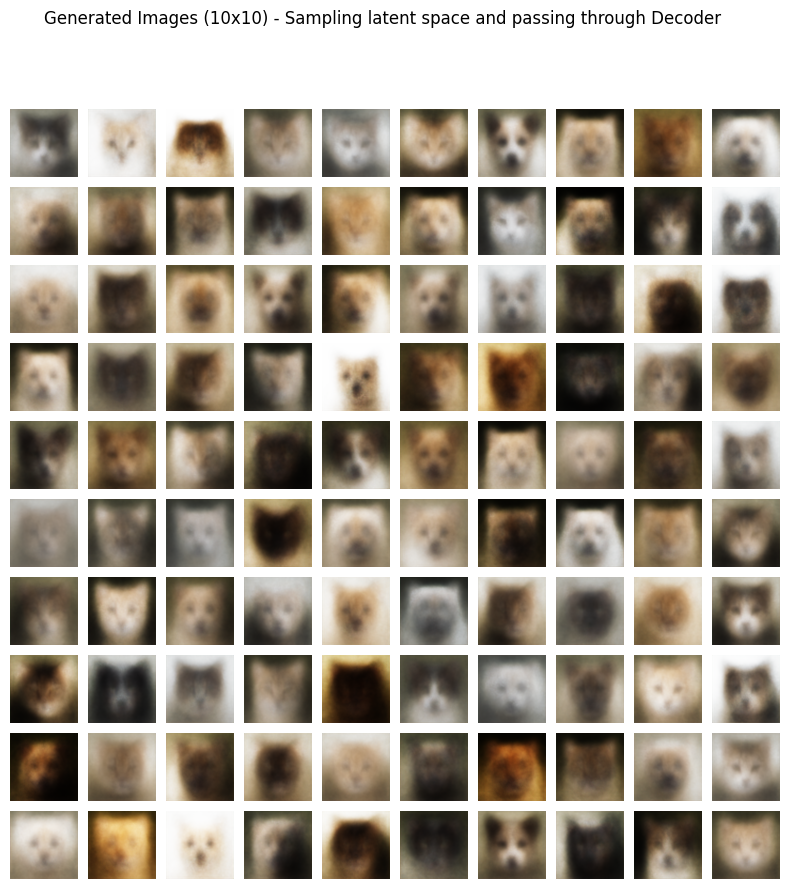

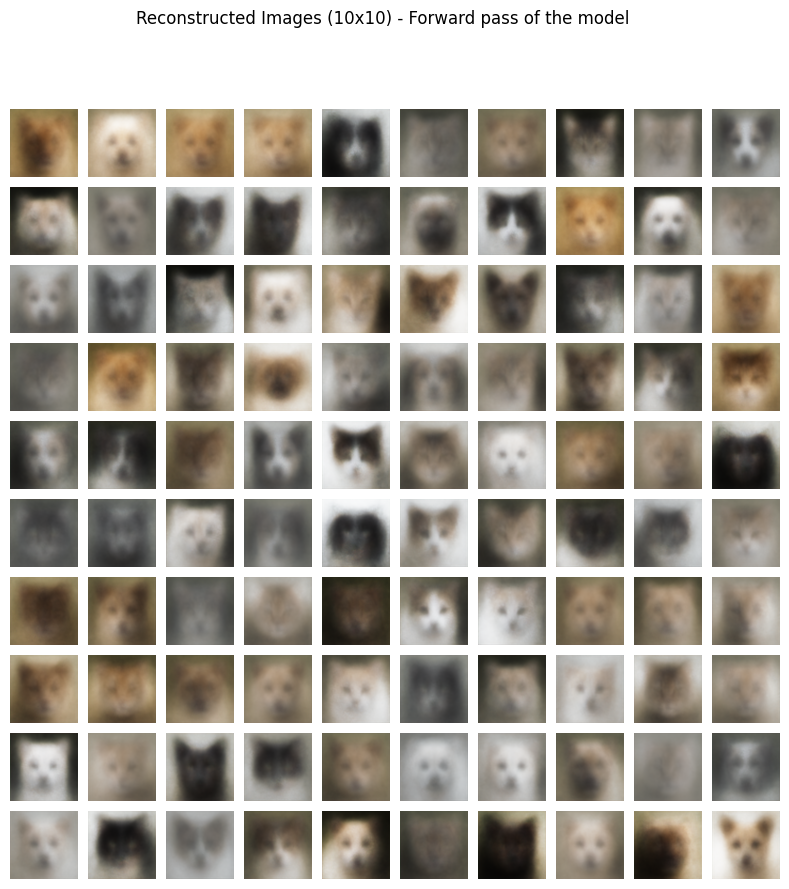

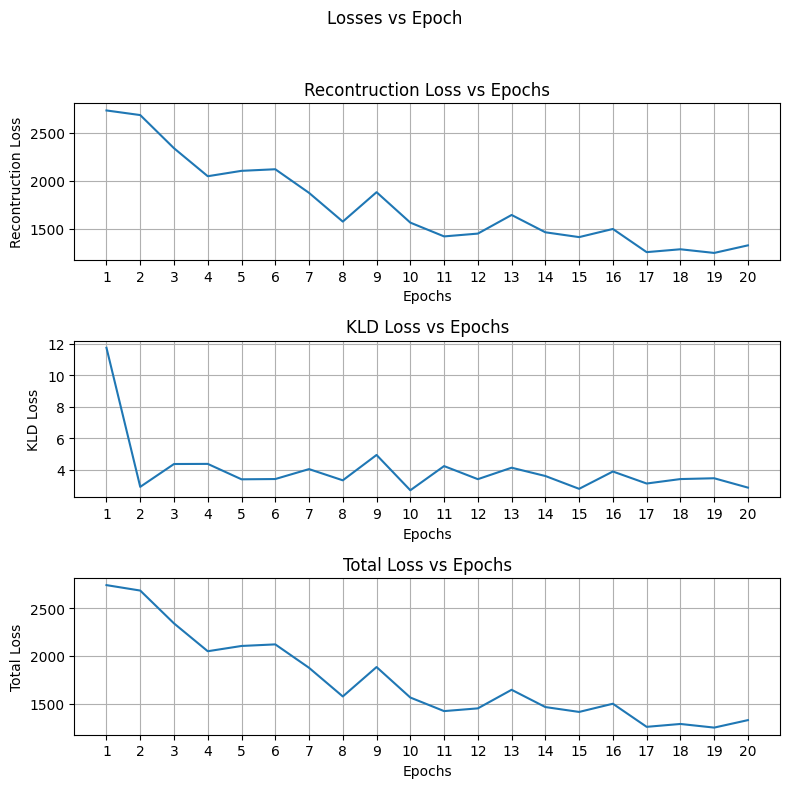

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 1)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list,KLD_loss_list)



#### Exp 1.2: Encoder is a FCN, Decoder is a CNN

##### Observations:
- Encoder seems to have done a weaker job compared to CNN Encoder.
- The KLD loss is relatively high, which translates into worse image generation. Where as the Reconstructed images are relatively good owing to the low reconstruction loss.

VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 1/20 | Rec Loss: 3017.371582 | KLD_loss: 21.213432 | Total loss: 3038.584961


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.73it/s]


	Epoch: 2/20 | Rec Loss: 2004.496094 | KLD_loss: 30.393892 | Total loss: 2034.890015


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.71it/s]


	Epoch: 3/20 | Rec Loss: 1685.381226 | KLD_loss: 21.804100 | Total loss: 1707.185303


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.54it/s]


	Epoch: 4/20 | Rec Loss: 1574.851440 | KLD_loss: 14.841394 | Total loss: 1589.692871


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.63it/s]


	Epoch: 5/20 | Rec Loss: 1517.614746 | KLD_loss: 14.028635 | Total loss: 1531.643433


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.67it/s]


	Epoch: 6/20 | Rec Loss: 1234.451660 | KLD_loss: 16.131643 | Total loss: 1250.583252


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.61it/s]


	Epoch: 7/20 | Rec Loss: 1374.959106 | KLD_loss: 15.601990 | Total loss: 1390.561035


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 8/20 | Rec Loss: 1243.021729 | KLD_loss: 15.939234 | Total loss: 1258.960938


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 9/20 | Rec Loss: 1281.255493 | KLD_loss: 10.290485 | Total loss: 1291.546021


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 10/20 | Rec Loss: 1035.563232 | KLD_loss: 9.251945 | Total loss: 1044.815186


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 11/20 | Rec Loss: 1043.474487 | KLD_loss: 12.769752 | Total loss: 1056.244263


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 12/20 | Rec Loss: 1018.270691 | KLD_loss: 11.886579 | Total loss: 1030.157227


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.59it/s]


	Epoch: 13/20 | Rec Loss: 948.518677 | KLD_loss: 10.233298 | Total loss: 958.751953


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.71it/s]


	Epoch: 14/20 | Rec Loss: 1128.326050 | KLD_loss: 8.956451 | Total loss: 1137.282471


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.63it/s]


	Epoch: 15/20 | Rec Loss: 952.492371 | KLD_loss: 8.205070 | Total loss: 960.697449


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 16/20 | Rec Loss: 968.694031 | KLD_loss: 8.237212 | Total loss: 976.931213


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.67it/s]


	Epoch: 17/20 | Rec Loss: 818.479553 | KLD_loss: 7.828397 | Total loss: 826.307922


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 18/20 | Rec Loss: 1044.757202 | KLD_loss: 9.640033 | Total loss: 1054.397217


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 19/20 | Rec Loss: 874.670837 | KLD_loss: 9.057855 | Total loss: 883.728699


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.60it/s]


	Epoch: 20/20 | Rec Loss: 842.891235 | KLD_loss: 7.970104 | Total loss: 850.861328


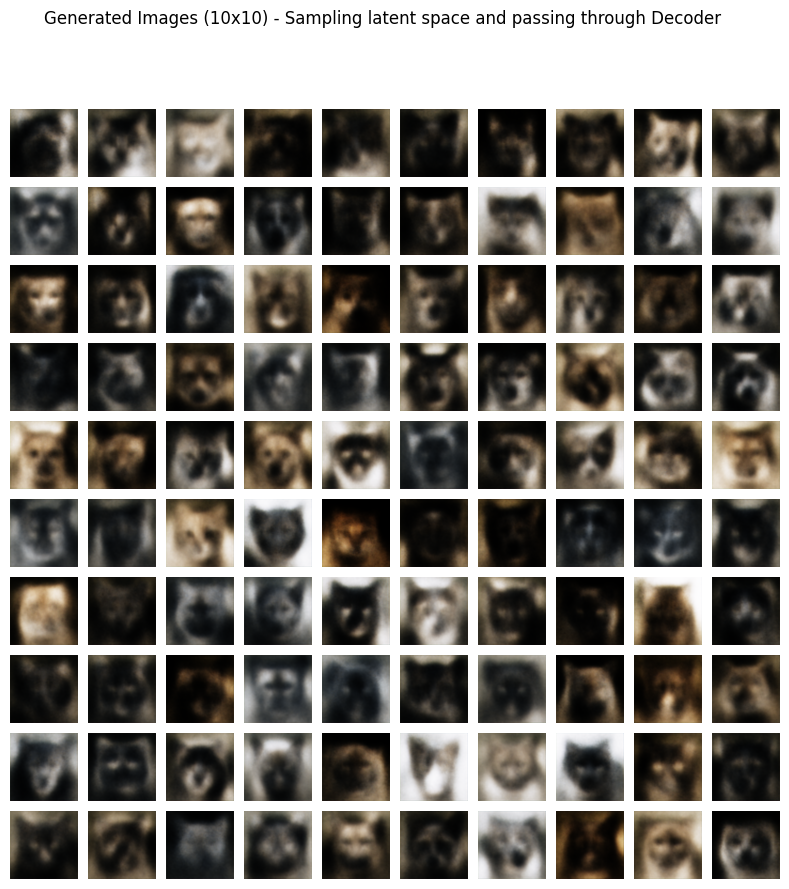

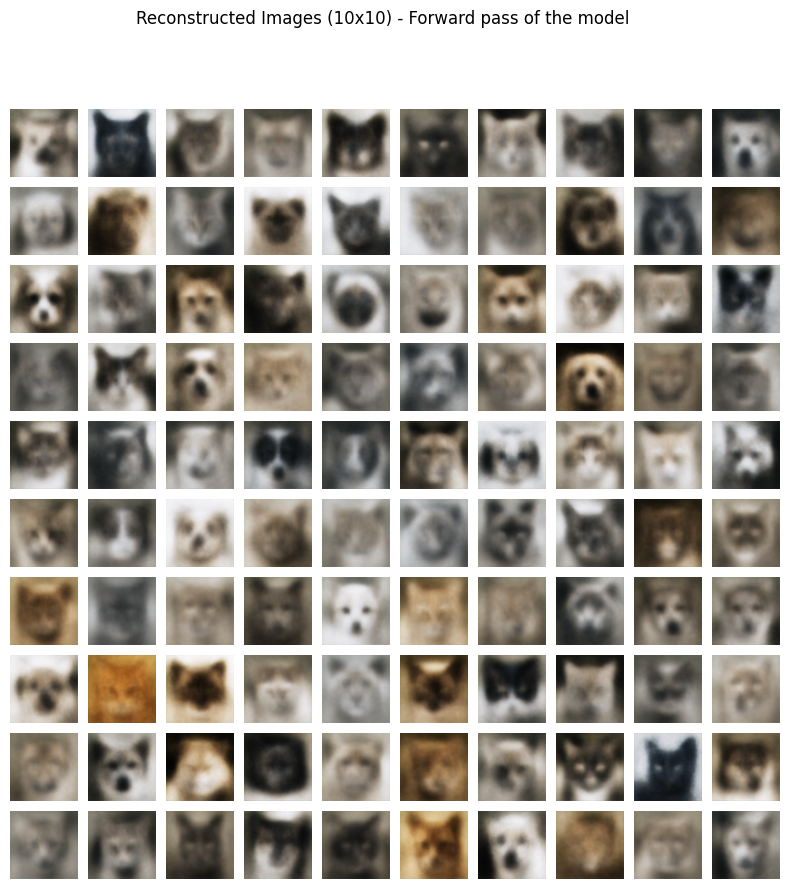

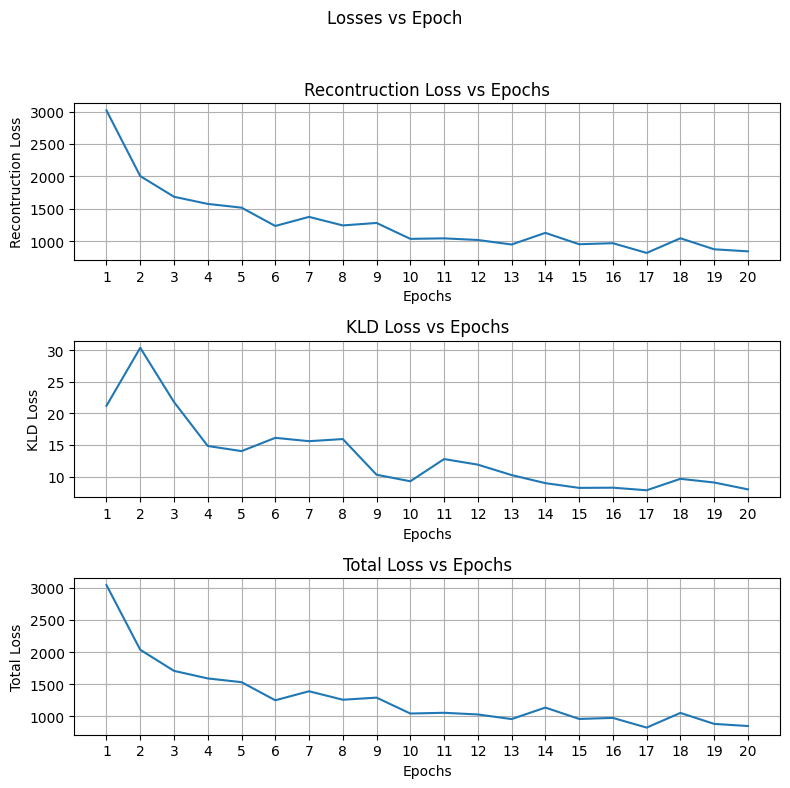

In [ ]:
model = VAE(Encoder_sel=1 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 1)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list,KLD_loss_list)


#### Exp 1.3: Encoder is a CNN, Decoder is a FCN

##### Observations:
- Better colors seen but spatial information lost
- Just like the previous experiment, the KLD loss is relatively high, which translates into worse image generation. Where as the Reconstructed images are the best so far, again owing to the low reconstruction loss.

VAE: 100%|██████████| 162/162 [00:09<00:00, 17.83it/s]


	Epoch: 1/20 | Rec Loss: 1981.286255 | KLD_loss: 14.933642 | Total loss: 1996.219849


VAE: 100%|██████████| 162/162 [00:08<00:00, 18.01it/s]


	Epoch: 2/20 | Rec Loss: 1746.354980 | KLD_loss: 11.028977 | Total loss: 1757.383911


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.92it/s]


	Epoch: 3/20 | Rec Loss: 1594.683105 | KLD_loss: 7.798668 | Total loss: 1602.481812


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.85it/s]


	Epoch: 4/20 | Rec Loss: 1431.650391 | KLD_loss: 9.931911 | Total loss: 1441.582275


VAE: 100%|██████████| 162/162 [00:08<00:00, 18.03it/s]


	Epoch: 5/20 | Rec Loss: 1472.896118 | KLD_loss: 8.199751 | Total loss: 1481.095825


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.73it/s]


	Epoch: 6/20 | Rec Loss: 1232.037842 | KLD_loss: 10.027741 | Total loss: 1242.065552


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.80it/s]


	Epoch: 7/20 | Rec Loss: 1496.043335 | KLD_loss: 9.384053 | Total loss: 1505.427368


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.49it/s]


	Epoch: 8/20 | Rec Loss: 1206.482544 | KLD_loss: 8.790704 | Total loss: 1215.273193


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.32it/s]


	Epoch: 9/20 | Rec Loss: 1212.457642 | KLD_loss: 7.783403 | Total loss: 1220.241089


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.62it/s]


	Epoch: 10/20 | Rec Loss: 1121.275269 | KLD_loss: 6.413043 | Total loss: 1127.688354


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.59it/s]


	Epoch: 11/20 | Rec Loss: 1161.677124 | KLD_loss: 5.749774 | Total loss: 1167.426880


VAE: 100%|██████████| 162/162 [00:08<00:00, 18.32it/s]


	Epoch: 12/20 | Rec Loss: 1048.819580 | KLD_loss: 7.519904 | Total loss: 1056.339478


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.61it/s]


	Epoch: 13/20 | Rec Loss: 1078.925903 | KLD_loss: 7.251373 | Total loss: 1086.177246


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.81it/s]


	Epoch: 14/20 | Rec Loss: 989.354492 | KLD_loss: 7.403302 | Total loss: 996.757812


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.40it/s]


	Epoch: 15/20 | Rec Loss: 993.039368 | KLD_loss: 8.005417 | Total loss: 1001.044800


VAE: 100%|██████████| 162/162 [00:08<00:00, 18.01it/s]


	Epoch: 16/20 | Rec Loss: 916.531616 | KLD_loss: 6.874408 | Total loss: 923.406006


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.76it/s]


	Epoch: 17/20 | Rec Loss: 1009.905273 | KLD_loss: 7.765408 | Total loss: 1017.670654


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.88it/s]


	Epoch: 18/20 | Rec Loss: 879.648376 | KLD_loss: 5.923859 | Total loss: 885.572266


VAE: 100%|██████████| 162/162 [00:08<00:00, 18.22it/s]


	Epoch: 19/20 | Rec Loss: 809.234131 | KLD_loss: 5.106123 | Total loss: 814.340271


VAE: 100%|██████████| 162/162 [00:09<00:00, 17.64it/s]


	Epoch: 20/20 | Rec Loss: 864.235291 | KLD_loss: 6.018468 | Total loss: 870.253784


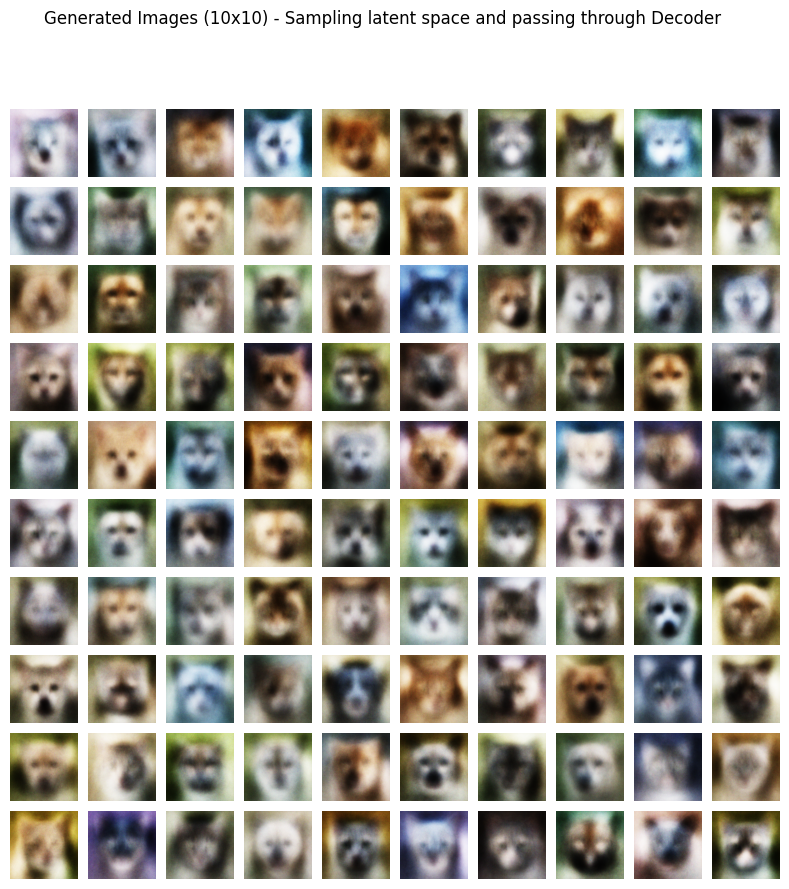

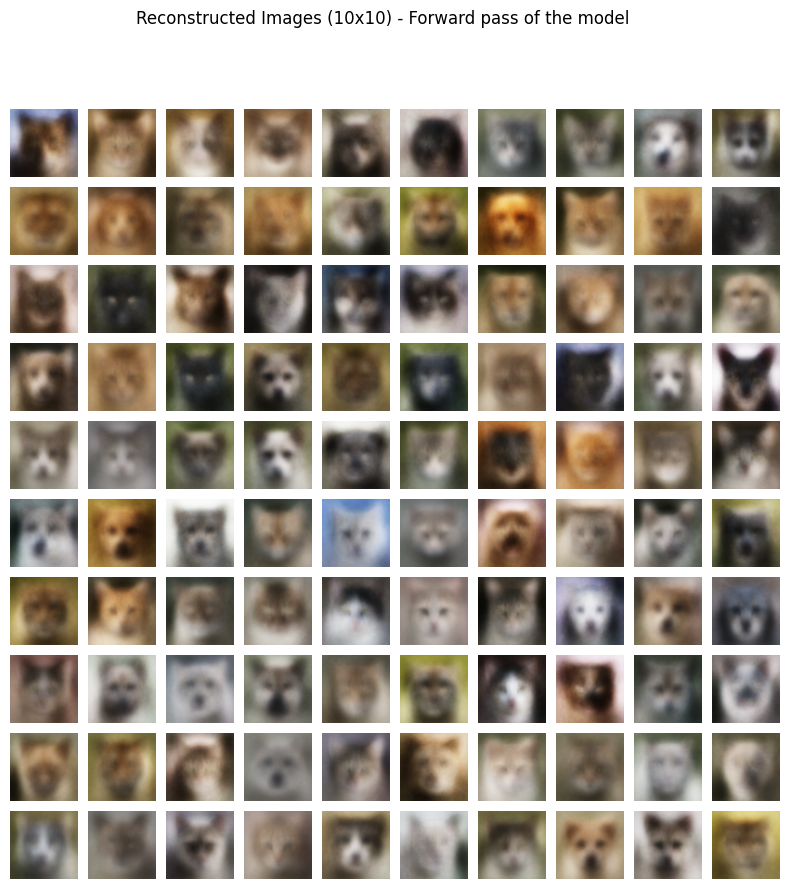

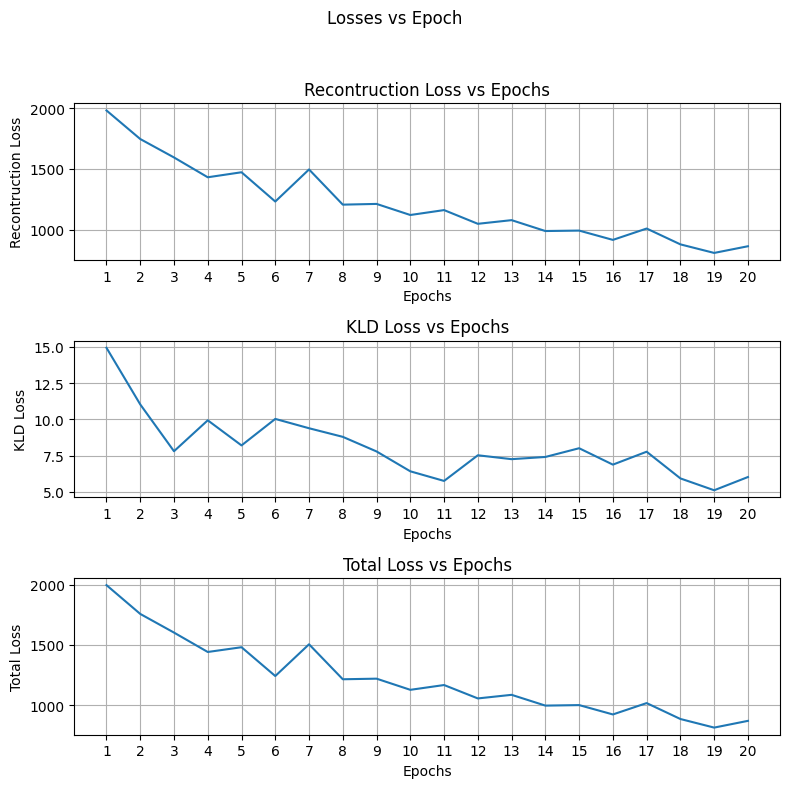

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=1, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 1)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list,KLD_loss_list)

### Exp Group 2: Test different losses (MSE loss vs Binary Cross Entropy loss)

- Exp 2.1: Exp1.1 with Binary Cross Entropy Loss is used instead of MSE Loss (Implies that $P_{\theta}(x|z)$ $\sim$ Bernoulli distribution)
  - BCE loss is well-suited for binary data, and it models the likelihood of each pixel being on (1) or off (0) independently. It is a more appropriate choice when working with image data in which pixel values are often treated as probabilities.
- Exp 2.2: With MSE loss (Same as Exp 1.1)


#### Observations

- The total loss increases with BCE as it is biased towards a higher value
- This leads to a higher reconstruction loss compared to KLD term leading to faster convergence across epochs (Gradients are higher)
- However need more experiments/scoring analysis to understand the generation capability as reconstruction is prioritized
- The image quality seems to be similar to MSE_loss as the output of VAE is already blurred
- No increase in color accuracy seen using the BCE loss also

#### Exp 2.1: With Binary Cross Entropy Loss

VAE: 100%|██████████| 162/162 [00:12<00:00, 13.43it/s]


	Epoch: 1/20 | Rec Loss: 32667.912109 | KLD_loss: 27.938988 | Total loss: 32695.851562


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.64it/s]


	Epoch: 2/20 | Rec Loss: 32708.847656 | KLD_loss: 9.263888 | Total loss: 32718.111328


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.65it/s]


	Epoch: 3/20 | Rec Loss: 31974.068359 | KLD_loss: 18.948721 | Total loss: 31993.017578


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 4/20 | Rec Loss: 32411.876953 | KLD_loss: 7.818228 | Total loss: 32419.695312


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 5/20 | Rec Loss: 31727.589844 | KLD_loss: 6.588874 | Total loss: 31734.179688


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 6/20 | Rec Loss: 31815.855469 | KLD_loss: 8.038791 | Total loss: 31823.894531


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 7/20 | Rec Loss: 31616.310547 | KLD_loss: 7.711243 | Total loss: 31624.021484


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 8/20 | Rec Loss: 30465.091797 | KLD_loss: 6.602307 | Total loss: 30471.693359


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.54it/s]


	Epoch: 9/20 | Rec Loss: 30704.296875 | KLD_loss: 7.180406 | Total loss: 30711.476562


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 10/20 | Rec Loss: 30530.572266 | KLD_loss: 9.638973 | Total loss: 30540.210938


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.43it/s]


	Epoch: 11/20 | Rec Loss: 30784.134766 | KLD_loss: 8.639452 | Total loss: 30792.773438


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 12/20 | Rec Loss: 31479.900391 | KLD_loss: 6.665984 | Total loss: 31486.566406


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 13/20 | Rec Loss: 30057.945312 | KLD_loss: 8.621240 | Total loss: 30066.566406


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 14/20 | Rec Loss: 29718.259766 | KLD_loss: 9.100224 | Total loss: 29727.359375


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 15/20 | Rec Loss: 30193.751953 | KLD_loss: 7.007885 | Total loss: 30200.759766


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 16/20 | Rec Loss: 30426.576172 | KLD_loss: 7.329286 | Total loss: 30433.906250


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.34it/s]


	Epoch: 17/20 | Rec Loss: 29885.152344 | KLD_loss: 7.362922 | Total loss: 29892.515625


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.38it/s]


	Epoch: 18/20 | Rec Loss: 30946.318359 | KLD_loss: 4.811885 | Total loss: 30951.130859


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.56it/s]


	Epoch: 19/20 | Rec Loss: 30732.951172 | KLD_loss: 4.946747 | Total loss: 30737.898438


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 20/20 | Rec Loss: 30548.826172 | KLD_loss: 5.463387 | Total loss: 30554.289062


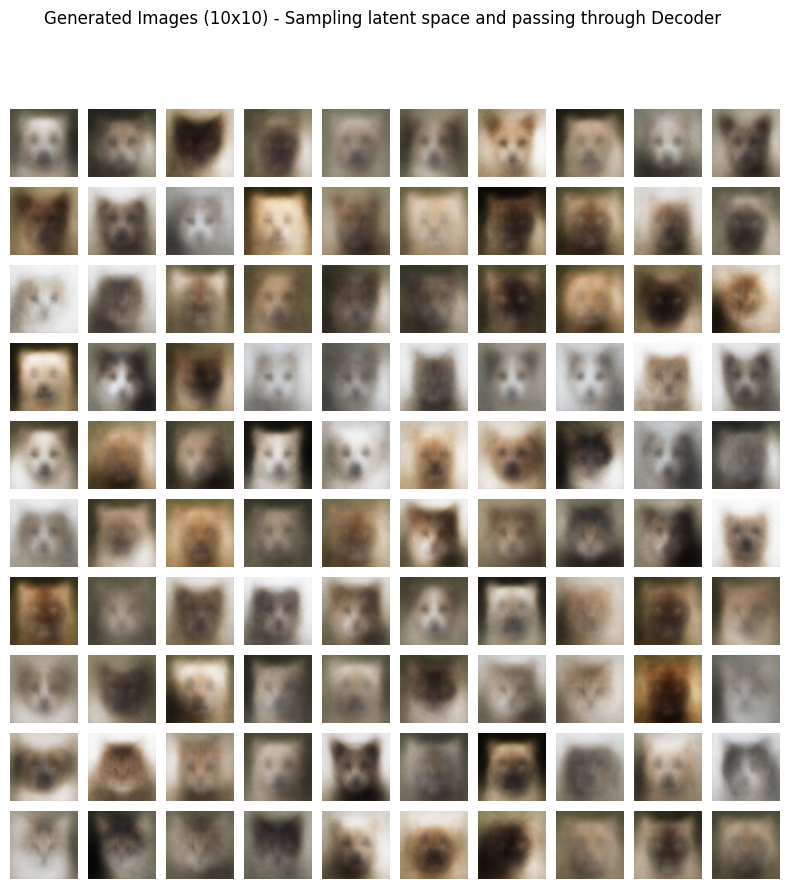

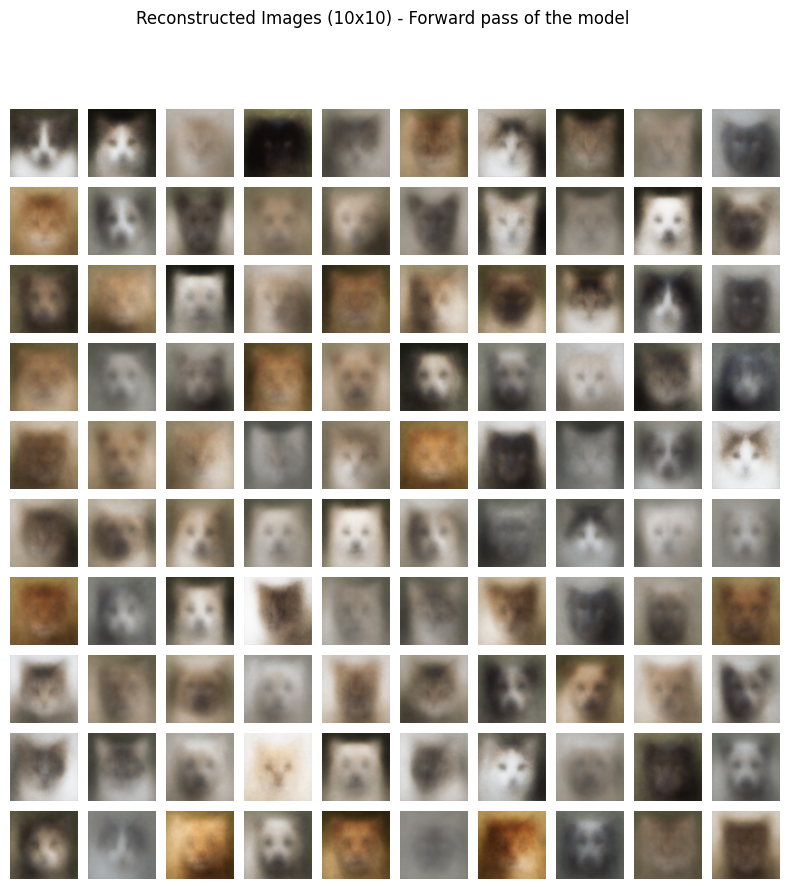

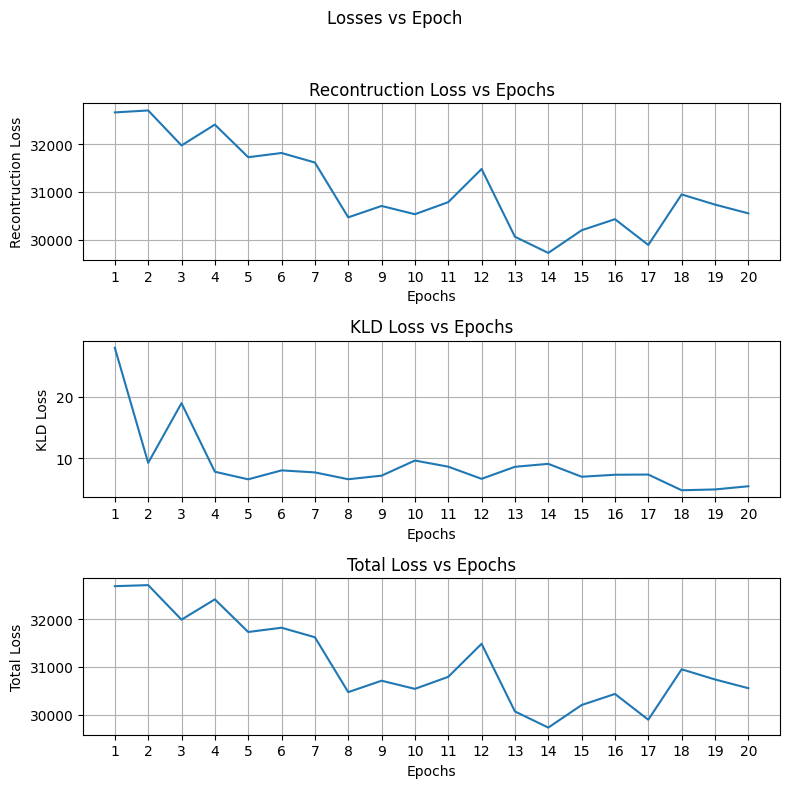

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'BCE', reduction_type = 'sum', num_z = 1, beta = 1)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list,KLD_loss_list)

### Exp Group 3: Experiments with learning rate

- Exp 3.1: Exp 1.1 with learning rate increased to 1e-3 from 1e-4
- Exp 3.2: Exp 1.1 (i.e. with learning rate of 1e-4)


#### Observations

- With learning rate of 1e-3, the images appear more blurry
- This could be due to higher oscillations/jumps during gradient descent (making it unable to converge to the minima)
- As can be seen the losses are slightly higher than that with lower learning rate (1e-4)
- The KLD Loss also doesnt seem to be settling

#### Exp 3.1: Exp 1.1 with learning rate increased to 1e-3 from 1e-4

VAE: 100%|██████████| 162/162 [00:11<00:00, 13.58it/s]


	Epoch: 1/20 | Rec Loss: 2318.299561 | KLD_loss: 2.802049 | Total loss: 2321.101562


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 2/20 | Rec Loss: 2098.229004 | KLD_loss: 2.918953 | Total loss: 2101.147949


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.59it/s]


	Epoch: 3/20 | Rec Loss: 2096.971436 | KLD_loss: 1.352576 | Total loss: 2098.323975


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 4/20 | Rec Loss: 2154.609375 | KLD_loss: 1.808712 | Total loss: 2156.417969


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 5/20 | Rec Loss: 1922.677368 | KLD_loss: 3.018282 | Total loss: 1925.695679


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 6/20 | Rec Loss: 1570.828247 | KLD_loss: 4.988321 | Total loss: 1575.816528


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 7/20 | Rec Loss: 1821.309814 | KLD_loss: 2.621226 | Total loss: 1823.931030


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 8/20 | Rec Loss: 1679.830322 | KLD_loss: 3.975020 | Total loss: 1683.805298


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 9/20 | Rec Loss: 1499.927368 | KLD_loss: 4.043936 | Total loss: 1503.971313


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 10/20 | Rec Loss: 1381.725830 | KLD_loss: 2.758568 | Total loss: 1384.484375


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.56it/s]


	Epoch: 11/20 | Rec Loss: 1520.994141 | KLD_loss: 1.915534 | Total loss: 1522.909668


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 12/20 | Rec Loss: 1389.682373 | KLD_loss: 3.112829 | Total loss: 1392.795166


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 13/20 | Rec Loss: 1358.379028 | KLD_loss: 3.017167 | Total loss: 1361.396240


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 14/20 | Rec Loss: 1436.013062 | KLD_loss: 3.650440 | Total loss: 1439.663452


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.63it/s]


	Epoch: 15/20 | Rec Loss: 1639.382324 | KLD_loss: 3.649135 | Total loss: 1643.031494


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 16/20 | Rec Loss: 1580.894653 | KLD_loss: 3.377264 | Total loss: 1584.271973


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 17/20 | Rec Loss: 1494.605347 | KLD_loss: 3.461412 | Total loss: 1498.066772


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 18/20 | Rec Loss: 1539.155029 | KLD_loss: 4.276947 | Total loss: 1543.432007


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 19/20 | Rec Loss: 1375.168335 | KLD_loss: 4.437555 | Total loss: 1379.605835


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 20/20 | Rec Loss: 1415.274658 | KLD_loss: 5.382720 | Total loss: 1420.657349


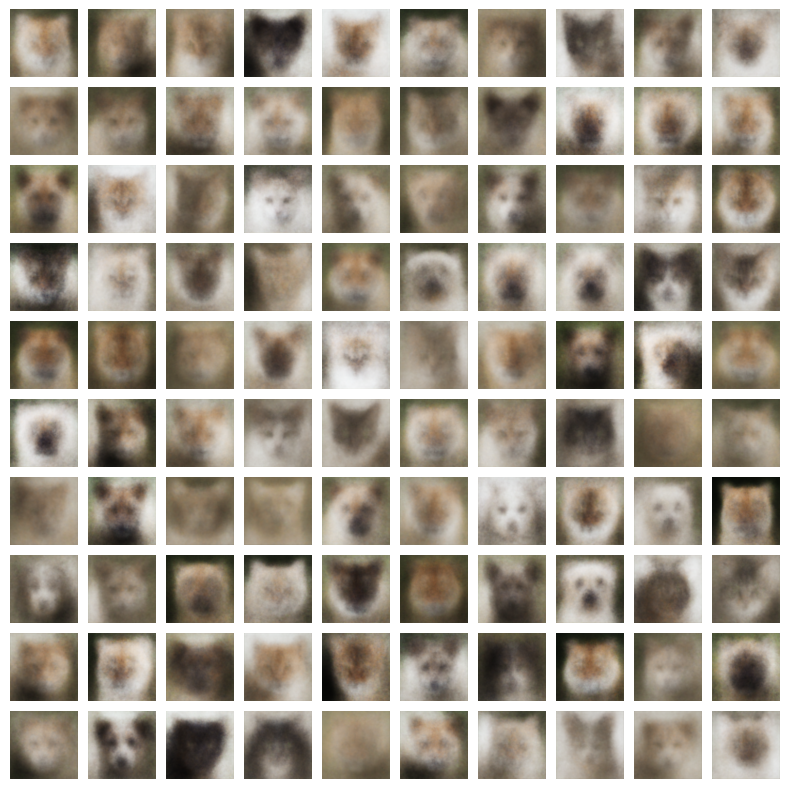

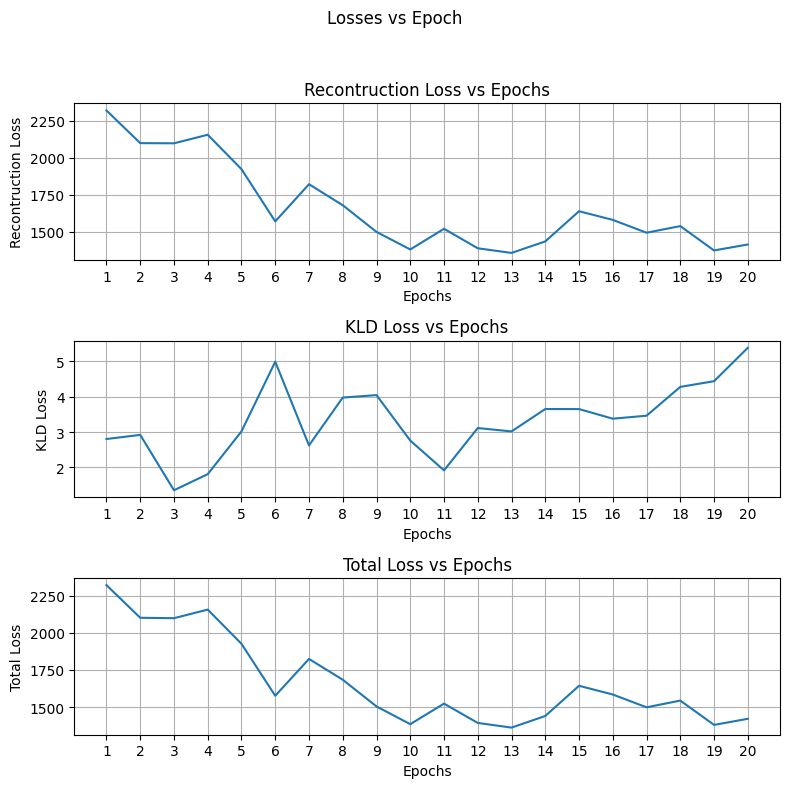

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-3)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 1)

plot_grid(model,latent_dim = 128, num_samples = 100)
plot_loss(Reconst_loss_list,KLD_loss_list)

### Exp Group 4: Experiments with reduction type for Loss function

- Exp 4.1: Exp 1.1 with reduction type set to 'mean' (This was done before fully exploring the documentation for nn.Functional.mse_loss() function)
- Exp 4.2: Exp 1.1 (i.e. with reduction type as 'sum' and then the summed loss divided by batch size*number of z instances)


#### Observations

- Inputs to the loss function are: (Batch size x z instances,d dimension data) -> both decoded and real data
- In case of reduction type as 'mean', pytorch calculates a mean across the d dim data and further on the batch size
- This leads to a very small Reconstruction loss (MSE loss), thereby overoptimizing the KLD (KLD loss of 10^-5 observed)
- The KLD loss being so low implies that $Q_{\phi}(z|x)$ almost exactly follows $P_{\theta}(z)$ leading to posterior collapse
- It can be seen that the generated images are all similar

Whereas in reduction type as sum, the MSE loss adds the l2-norm across the batch size. On dividing by batch size it gives the true mean

#### Exp 4.1: Exp 1.1 (i.e. with reduction type as 'mean')

Please scroll up to output of Exp 1.1 to compare the images that were generated.

VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 1/20 | Rec Loss: 0.058934 | KLD_loss: 0.000064 | Total loss: 0.058999


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.61it/s]


	Epoch: 2/20 | Rec Loss: 0.059800 | KLD_loss: 0.000034 | Total loss: 0.059834


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 3/20 | Rec Loss: 0.053095 | KLD_loss: 0.000029 | Total loss: 0.053125


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 4/20 | Rec Loss: 0.062544 | KLD_loss: 0.000022 | Total loss: 0.062566


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 5/20 | Rec Loss: 0.064098 | KLD_loss: 0.000022 | Total loss: 0.064120


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 6/20 | Rec Loss: 0.054184 | KLD_loss: 0.000022 | Total loss: 0.054206


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 7/20 | Rec Loss: 0.053740 | KLD_loss: 0.000018 | Total loss: 0.053758


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 8/20 | Rec Loss: 0.053481 | KLD_loss: 0.000024 | Total loss: 0.053505


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 9/20 | Rec Loss: 0.058466 | KLD_loss: 0.000014 | Total loss: 0.058480


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 10/20 | Rec Loss: 0.068379 | KLD_loss: 0.000014 | Total loss: 0.068393


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 11/20 | Rec Loss: 0.061902 | KLD_loss: 0.000014 | Total loss: 0.061916


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 12/20 | Rec Loss: 0.058613 | KLD_loss: 0.000014 | Total loss: 0.058626


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.61it/s]


	Epoch: 13/20 | Rec Loss: 0.061760 | KLD_loss: 0.000012 | Total loss: 0.061772


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 14/20 | Rec Loss: 0.058710 | KLD_loss: 0.000009 | Total loss: 0.058719


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 15/20 | Rec Loss: 0.054828 | KLD_loss: 0.000013 | Total loss: 0.054841


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 16/20 | Rec Loss: 0.056133 | KLD_loss: 0.000010 | Total loss: 0.056143


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 17/20 | Rec Loss: 0.057516 | KLD_loss: 0.000008 | Total loss: 0.057524


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.61it/s]


	Epoch: 18/20 | Rec Loss: 0.061669 | KLD_loss: 0.000009 | Total loss: 0.061678


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 19/20 | Rec Loss: 0.063938 | KLD_loss: 0.000011 | Total loss: 0.063949


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.61it/s]


	Epoch: 20/20 | Rec Loss: 0.059104 | KLD_loss: 0.000010 | Total loss: 0.059114


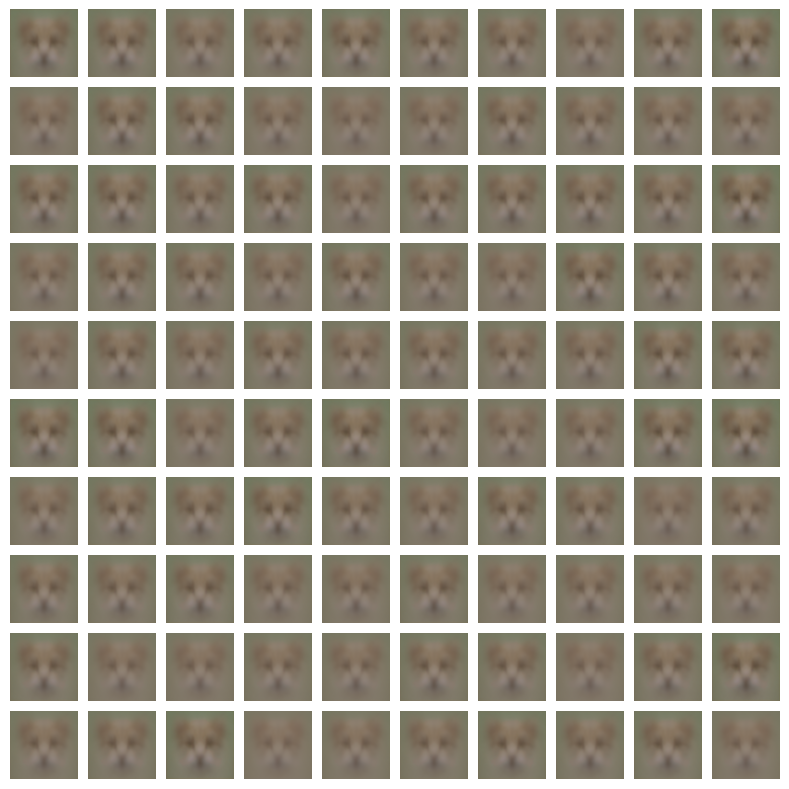

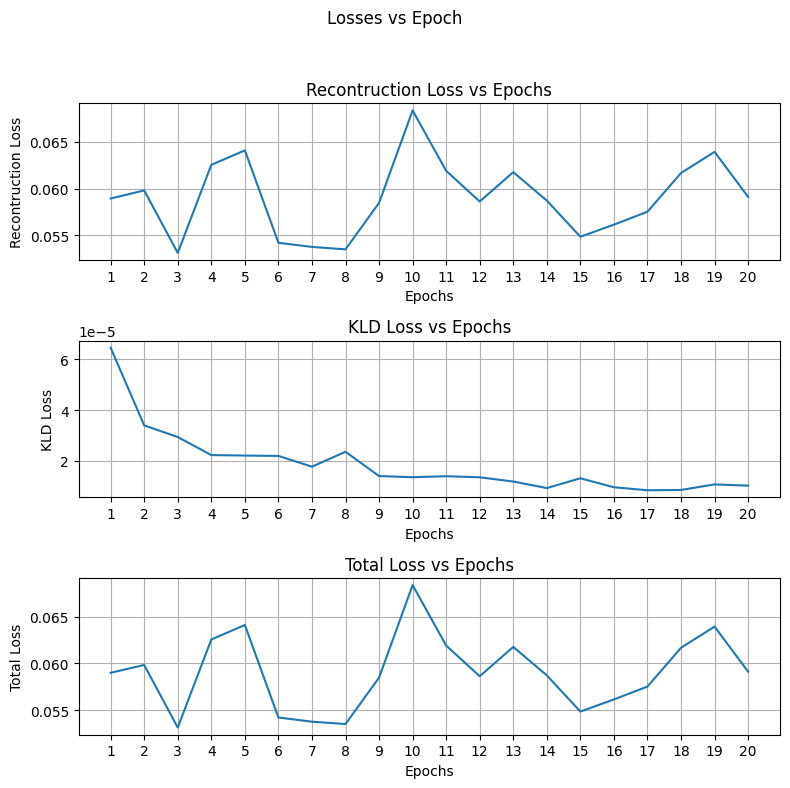

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'mean', num_z = 1, beta = 1)

plot_grid(model,latent_dim = 128, num_samples = 100)
plot_loss(Reconst_loss_list,KLD_loss_list)

### Exp Group 5: Experiments with latent dimensions

- Exp 5.1: Exp 1.1 with latent dimension of 32
- Exp 5.2: Exp 1.1 with latent dimension of 512
- Exp 5.3: Exp 1.1 (i.e. with latent dimension of 128)


#### Observations

- With latent dim of 32, the images appear more blurry, some images generated dont look like animals similar to dataset (Although the losses are less)
- With latent dim of 512, the losses are more indicating that more training over epochs needs to be done
    - Apart from being washed out images, the faces of animals look similar to the case with latent dimension as 128
    - No significant advantage of the higher dim over latent dim 128 case

#### Exp 5.1: Exp 1.1 with latent dimension of 32

VAE: 100%|██████████| 162/162 [00:12<00:00, 13.43it/s]


	Epoch: 1/20 | Rec Loss: 2526.270508 | KLD_loss: 10.205620 | Total loss: 2536.476074


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 2/20 | Rec Loss: 2114.473145 | KLD_loss: 4.069462 | Total loss: 2118.542725


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 3/20 | Rec Loss: 1806.862915 | KLD_loss: 6.487075 | Total loss: 1813.349976


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 4/20 | Rec Loss: 1815.192505 | KLD_loss: 3.246510 | Total loss: 1818.438965


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.45it/s]


	Epoch: 5/20 | Rec Loss: 2029.580566 | KLD_loss: 3.856797 | Total loss: 2033.437378


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 6/20 | Rec Loss: 1750.134521 | KLD_loss: 3.904928 | Total loss: 1754.039429


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 7/20 | Rec Loss: 1841.964844 | KLD_loss: 4.828997 | Total loss: 1846.793823


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 8/20 | Rec Loss: 1627.477295 | KLD_loss: 3.940314 | Total loss: 1631.417603


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 9/20 | Rec Loss: 1395.060059 | KLD_loss: 3.563672 | Total loss: 1398.623779


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 10/20 | Rec Loss: 1457.424316 | KLD_loss: 3.247391 | Total loss: 1460.671753


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 11/20 | Rec Loss: 1487.100830 | KLD_loss: 3.853457 | Total loss: 1490.954346


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.41it/s]


	Epoch: 12/20 | Rec Loss: 1231.512329 | KLD_loss: 3.318304 | Total loss: 1234.830688


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 13/20 | Rec Loss: 1361.955566 | KLD_loss: 3.127999 | Total loss: 1365.083618


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 14/20 | Rec Loss: 1267.746460 | KLD_loss: 2.463561 | Total loss: 1270.209961


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 15/20 | Rec Loss: 1317.556885 | KLD_loss: 3.233862 | Total loss: 1320.790771


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 16/20 | Rec Loss: 1280.875366 | KLD_loss: 2.739658 | Total loss: 1283.614990


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 17/20 | Rec Loss: 1146.089355 | KLD_loss: 2.504438 | Total loss: 1148.593750


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.60it/s]


	Epoch: 18/20 | Rec Loss: 1419.421143 | KLD_loss: 2.859556 | Total loss: 1422.280640


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 19/20 | Rec Loss: 1100.232056 | KLD_loss: 2.691828 | Total loss: 1102.923828


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 20/20 | Rec Loss: 1157.675293 | KLD_loss: 2.530833 | Total loss: 1160.206177


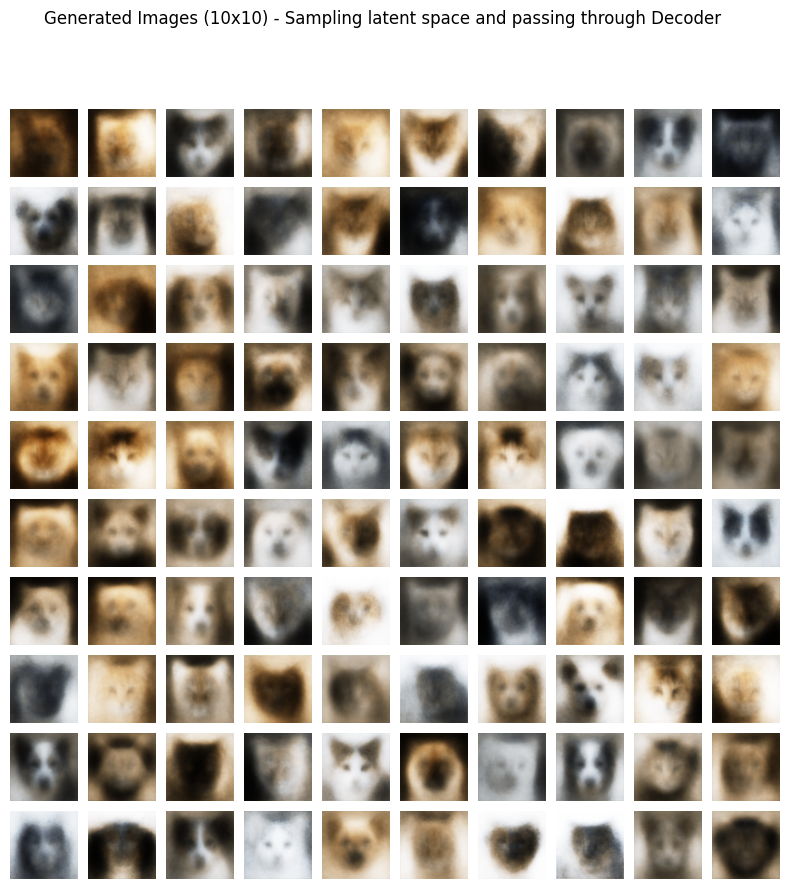

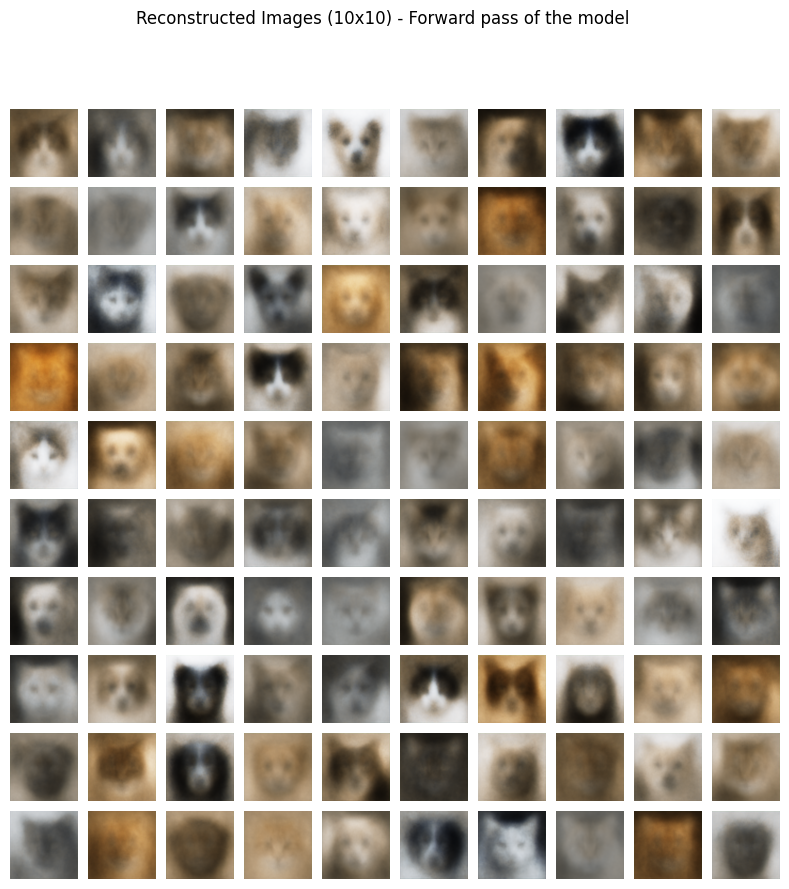

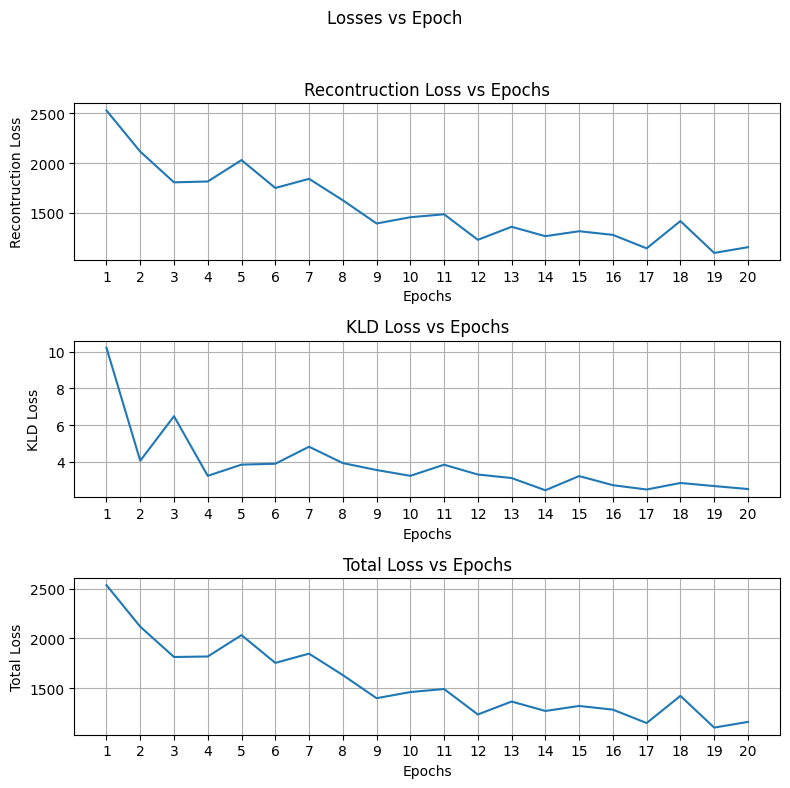

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 32, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 1)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 32, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list,KLD_loss_list)

#### Exp 5.1: Exp 1.1 with latent dimension of 512

VAE: 100%|██████████| 162/162 [00:11<00:00, 13.56it/s]


	Epoch: 1/20 | Rec Loss: 2517.573975 | KLD_loss: 8.723228 | Total loss: 2526.297119


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 2/20 | Rec Loss: 2440.491699 | KLD_loss: 2.854864 | Total loss: 2443.346680


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.54it/s]


	Epoch: 3/20 | Rec Loss: 2514.150391 | KLD_loss: 1.458150 | Total loss: 2515.608643


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 4/20 | Rec Loss: 2438.190674 | KLD_loss: 3.510768 | Total loss: 2441.701416


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.50it/s]


	Epoch: 5/20 | Rec Loss: 2352.656738 | KLD_loss: 1.531472 | Total loss: 2354.188232


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 6/20 | Rec Loss: 1870.111328 | KLD_loss: 9.063060 | Total loss: 1879.174438


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.31it/s]


	Epoch: 7/20 | Rec Loss: 2210.498047 | KLD_loss: 2.197053 | Total loss: 2212.695068


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.43it/s]


	Epoch: 8/20 | Rec Loss: 2000.539429 | KLD_loss: 2.619715 | Total loss: 2003.159180


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 9/20 | Rec Loss: 2170.279785 | KLD_loss: 1.797363 | Total loss: 2172.077148


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.62it/s]


	Epoch: 10/20 | Rec Loss: 2197.715332 | KLD_loss: 2.378733 | Total loss: 2200.093994


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.47it/s]


	Epoch: 11/20 | Rec Loss: 1776.266235 | KLD_loss: 3.338906 | Total loss: 1779.605103


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 12/20 | Rec Loss: 1616.506104 | KLD_loss: 2.766747 | Total loss: 1619.272827


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 13/20 | Rec Loss: 1723.908447 | KLD_loss: 4.542439 | Total loss: 1728.450928


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.56it/s]


	Epoch: 14/20 | Rec Loss: 1691.845947 | KLD_loss: 4.337841 | Total loss: 1696.183838


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.47it/s]


	Epoch: 15/20 | Rec Loss: 1422.820435 | KLD_loss: 4.611736 | Total loss: 1427.432129


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 16/20 | Rec Loss: 1579.222534 | KLD_loss: 4.453824 | Total loss: 1583.676392


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 17/20 | Rec Loss: 1402.149292 | KLD_loss: 2.817322 | Total loss: 1404.966675


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 18/20 | Rec Loss: 1578.729980 | KLD_loss: 2.953193 | Total loss: 1581.683228


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 19/20 | Rec Loss: 1219.349854 | KLD_loss: 2.829505 | Total loss: 1222.179321


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 20/20 | Rec Loss: 1455.915405 | KLD_loss: 3.123760 | Total loss: 1459.039185


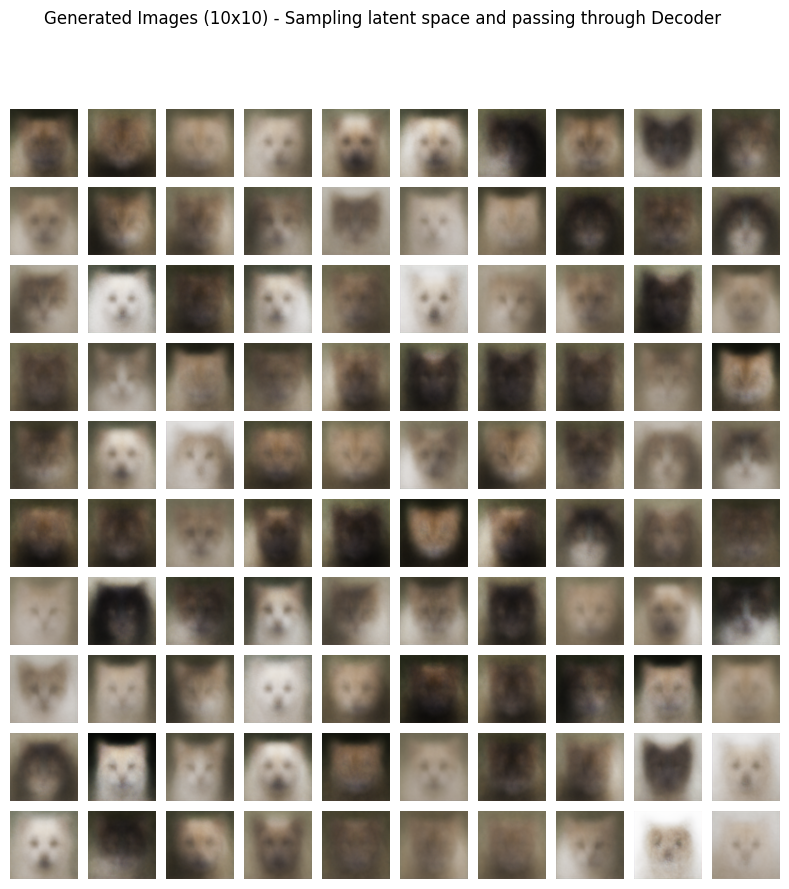

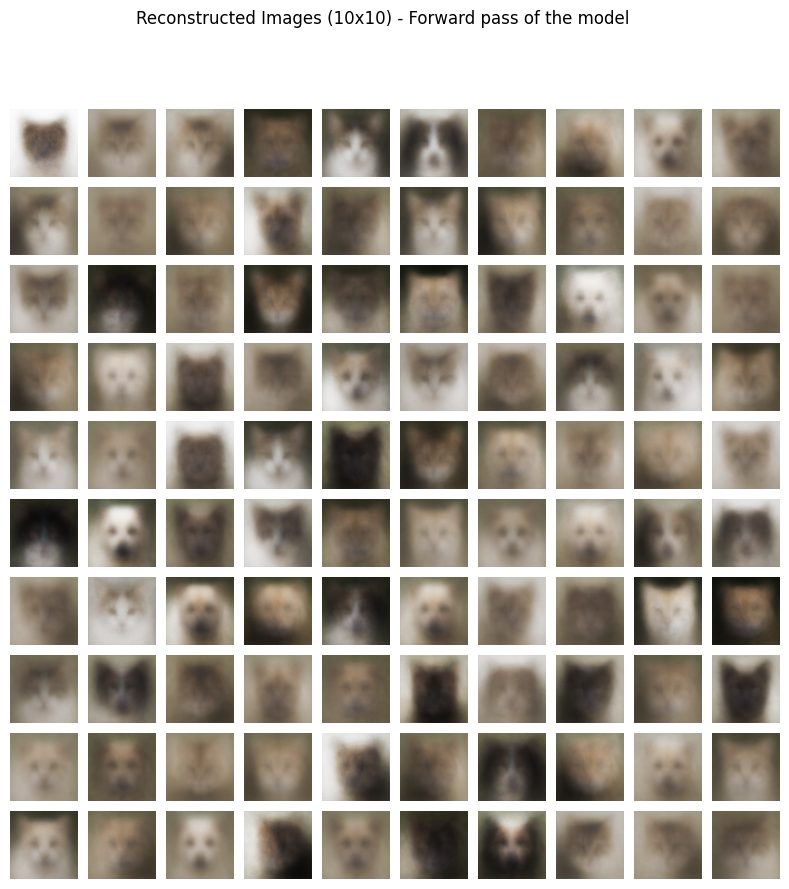

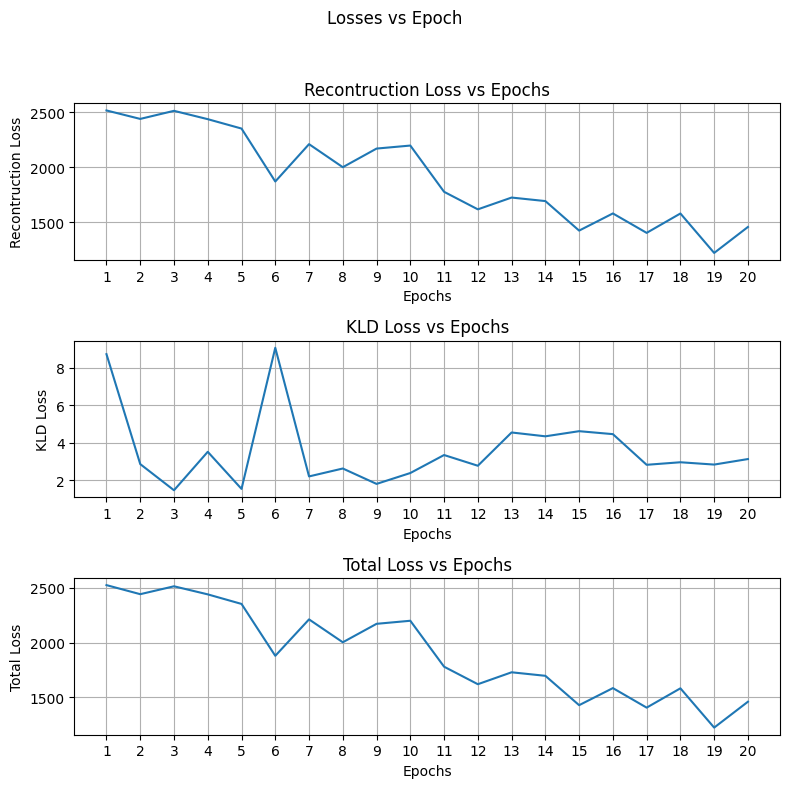

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 512, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 1)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 512, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list,KLD_loss_list)

### Exp Group 6: Experiments with different number of z instances

- Exp 6.1: Exp 1.1 with number of z as 10
- Exp 6.2: Exp 1.1 with number of z as 20
- Exp 6.3: Exp 1.1 with number of z as 50
- Exp 6.4: Exp 1.1 (i.e. with number of z as 1)


#### Observations

- With higher number of z, the losses have reduced. However the generated images are not accurate (Some images are similar to animals in Dataset but most of them are not accurate)
- The colors however seem to be more accurate

Note: Batch size is reduced to 10 to reduce the computation and memory requirement

#### Exp 6.1: Exp 1.1 with number of z as 10

In [ ]:
transform = transforms.Compose(
    [
        transforms.Resize(size=128),
        transforms.ToTensor()
    ]

)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#train_data = datasets.ImageFolder('/content/drive/MyDrive/ADRL Assignment/data/',transform=transform)
train_data = datasets.ImageFolder('.\\archive\\afhq\\',transform=transform)
batch_size = 10
train_loader = DataLoader(train_data,batch_size=batch_size,shuffle=True,num_workers=4)

VAE: 100%|██████████| 1613/1613 [01:36<00:00, 16.63it/s]


	Epoch: 1/20 | Rec Loss: 1915.891235 | KLD_loss: 5.512288 | Total loss: 1921.403564


VAE: 100%|██████████| 1613/1613 [01:33<00:00, 17.31it/s]


	Epoch: 2/20 | Rec Loss: 1687.914062 | KLD_loss: 3.292474 | Total loss: 1691.206543


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.37it/s]


	Epoch: 3/20 | Rec Loss: 1630.873413 | KLD_loss: 2.218147 | Total loss: 1633.091553


VAE: 100%|██████████| 1613/1613 [01:33<00:00, 17.29it/s]


	Epoch: 4/20 | Rec Loss: 1544.943115 | KLD_loss: 1.823344 | Total loss: 1546.766479


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.37it/s]


	Epoch: 5/20 | Rec Loss: 1354.702515 | KLD_loss: 1.988592 | Total loss: 1356.691162


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.37it/s]


	Epoch: 6/20 | Rec Loss: 1261.995117 | KLD_loss: 2.016626 | Total loss: 1264.011719


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.41it/s]


	Epoch: 7/20 | Rec Loss: 1255.420044 | KLD_loss: 1.947431 | Total loss: 1257.367432


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.44it/s]


	Epoch: 8/20 | Rec Loss: 1137.040894 | KLD_loss: 2.371494 | Total loss: 1139.412354


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.38it/s]


	Epoch: 9/20 | Rec Loss: 1084.586548 | KLD_loss: 1.604449 | Total loss: 1086.191040


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.39it/s]


	Epoch: 10/20 | Rec Loss: 899.811707 | KLD_loss: 3.165190 | Total loss: 902.976868


VAE: 100%|██████████| 1613/1613 [01:33<00:00, 17.30it/s]


	Epoch: 11/20 | Rec Loss: 1027.957275 | KLD_loss: 2.305509 | Total loss: 1030.262817


VAE: 100%|██████████| 1613/1613 [01:34<00:00, 17.16it/s]


	Epoch: 12/20 | Rec Loss: 1112.835449 | KLD_loss: 1.773133 | Total loss: 1114.608643


VAE: 100%|██████████| 1613/1613 [01:33<00:00, 17.32it/s]


	Epoch: 13/20 | Rec Loss: 892.678711 | KLD_loss: 1.280647 | Total loss: 893.959351


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.47it/s]


	Epoch: 14/20 | Rec Loss: 1202.472168 | KLD_loss: 2.968217 | Total loss: 1205.440430


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.44it/s]


	Epoch: 15/20 | Rec Loss: 958.521851 | KLD_loss: 2.762363 | Total loss: 961.284241


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.43it/s]


	Epoch: 16/20 | Rec Loss: 776.305786 | KLD_loss: 2.430886 | Total loss: 778.736694


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.45it/s]


	Epoch: 17/20 | Rec Loss: 854.846924 | KLD_loss: 2.465756 | Total loss: 857.312683


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.52it/s]


	Epoch: 18/20 | Rec Loss: 921.609802 | KLD_loss: 2.353482 | Total loss: 923.963257


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.43it/s]


	Epoch: 19/20 | Rec Loss: 651.470032 | KLD_loss: 2.217561 | Total loss: 653.687622


VAE: 100%|██████████| 1613/1613 [01:32<00:00, 17.47it/s]


	Epoch: 20/20 | Rec Loss: 853.459961 | KLD_loss: 2.790223 | Total loss: 856.250183


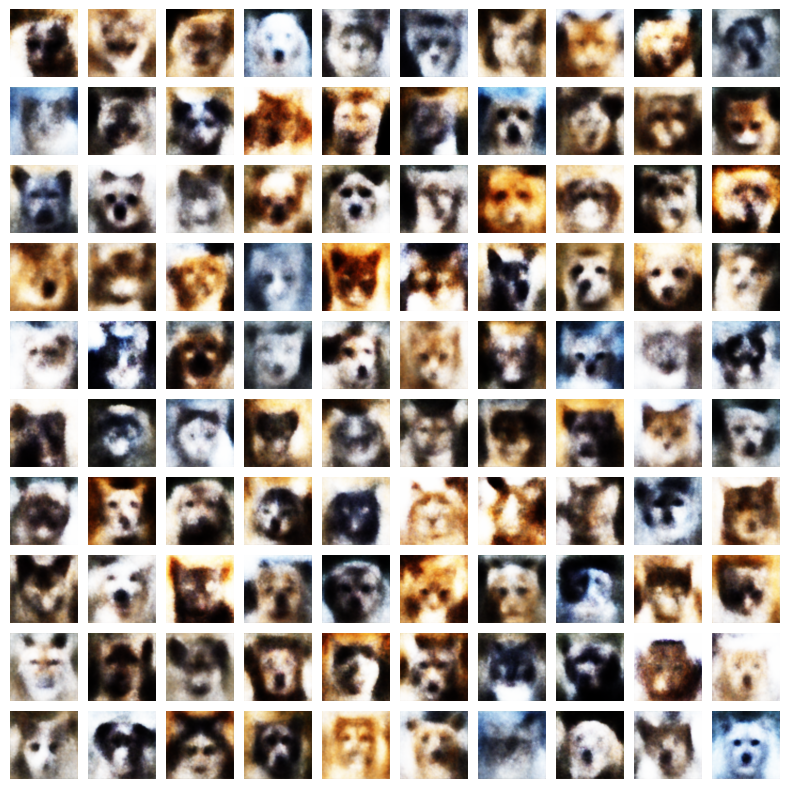

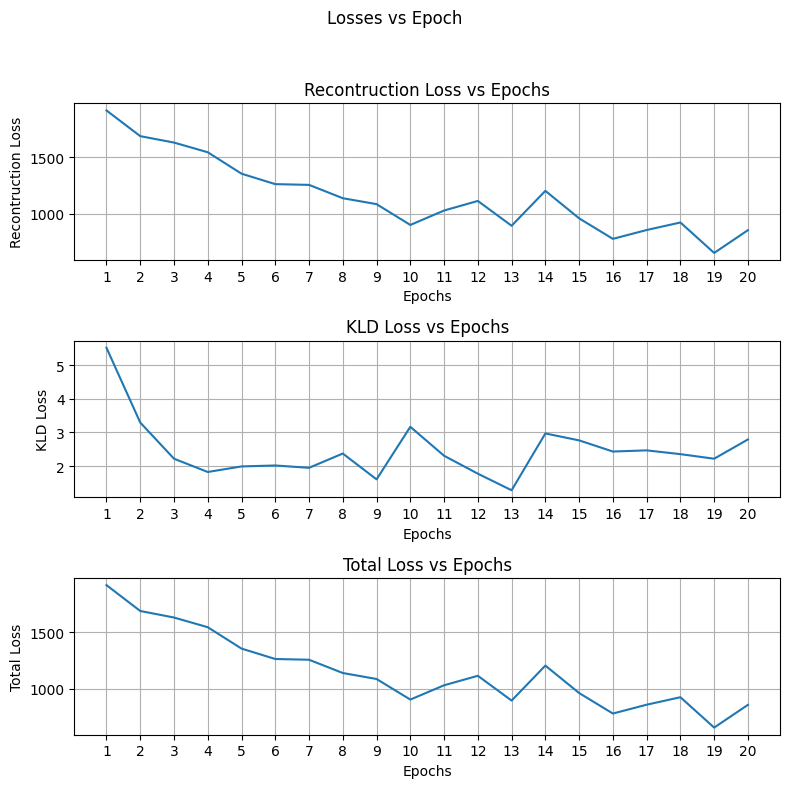

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 10, beta = 1)

plot_grid(model,latent_dim = 128, num_samples = 100)
plot_loss(Reconst_loss_list,KLD_loss_list)

#### Exp 6.2: Exp 1.1 with number of z as 20

VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.02it/s]


	Epoch: 1/20 | Rec Loss: 1759.608398 | KLD_loss: 2.834277 | Total loss: 1762.442627


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.01it/s]


	Epoch: 2/20 | Rec Loss: 1556.414917 | KLD_loss: 3.394468 | Total loss: 1559.809326


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.01it/s]


	Epoch: 3/20 | Rec Loss: 1465.218994 | KLD_loss: 2.457393 | Total loss: 1467.676392


VAE: 100%|██████████| 1613/1613 [02:13<00:00, 12.04it/s]


	Epoch: 4/20 | Rec Loss: 1430.441162 | KLD_loss: 1.920444 | Total loss: 1432.361572


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.04it/s]


	Epoch: 5/20 | Rec Loss: 1454.332520 | KLD_loss: 1.688582 | Total loss: 1456.021118


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.02it/s]


	Epoch: 6/20 | Rec Loss: 1149.908936 | KLD_loss: 4.784656 | Total loss: 1154.693604


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 11.99it/s]


	Epoch: 7/20 | Rec Loss: 1149.496948 | KLD_loss: 2.101648 | Total loss: 1151.598633


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.03it/s]


	Epoch: 8/20 | Rec Loss: 1059.933472 | KLD_loss: 3.012700 | Total loss: 1062.946167


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.03it/s]


	Epoch: 9/20 | Rec Loss: 1106.560181 | KLD_loss: 3.154541 | Total loss: 1109.714722


VAE: 100%|██████████| 1613/1613 [02:13<00:00, 12.06it/s]


	Epoch: 10/20 | Rec Loss: 891.082031 | KLD_loss: 2.026507 | Total loss: 893.108521


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.03it/s]


	Epoch: 11/20 | Rec Loss: 917.983093 | KLD_loss: 1.611443 | Total loss: 919.594543


VAE: 100%|██████████| 1613/1613 [02:13<00:00, 12.06it/s]


	Epoch: 12/20 | Rec Loss: 1054.718750 | KLD_loss: 2.036800 | Total loss: 1056.755493


VAE: 100%|██████████| 1613/1613 [02:13<00:00, 12.04it/s]


	Epoch: 13/20 | Rec Loss: 1029.801880 | KLD_loss: 1.972794 | Total loss: 1031.774658


VAE: 100%|██████████| 1613/1613 [02:13<00:00, 12.05it/s]


	Epoch: 14/20 | Rec Loss: 998.099060 | KLD_loss: 2.128943 | Total loss: 1000.228027


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.03it/s]


	Epoch: 15/20 | Rec Loss: 972.791992 | KLD_loss: 2.163531 | Total loss: 974.955505


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.02it/s]


	Epoch: 16/20 | Rec Loss: 940.424255 | KLD_loss: 1.660365 | Total loss: 942.084595


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 11.95it/s]


	Epoch: 17/20 | Rec Loss: 708.121094 | KLD_loss: 2.601133 | Total loss: 710.722229


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 11.98it/s]


	Epoch: 18/20 | Rec Loss: 709.026245 | KLD_loss: 2.586293 | Total loss: 711.612549


VAE: 100%|██████████| 1613/1613 [02:13<00:00, 12.07it/s]


	Epoch: 19/20 | Rec Loss: 800.464355 | KLD_loss: 2.922315 | Total loss: 803.386658


VAE: 100%|██████████| 1613/1613 [02:14<00:00, 12.03it/s]


	Epoch: 20/20 | Rec Loss: 882.250854 | KLD_loss: 1.946551 | Total loss: 884.197388


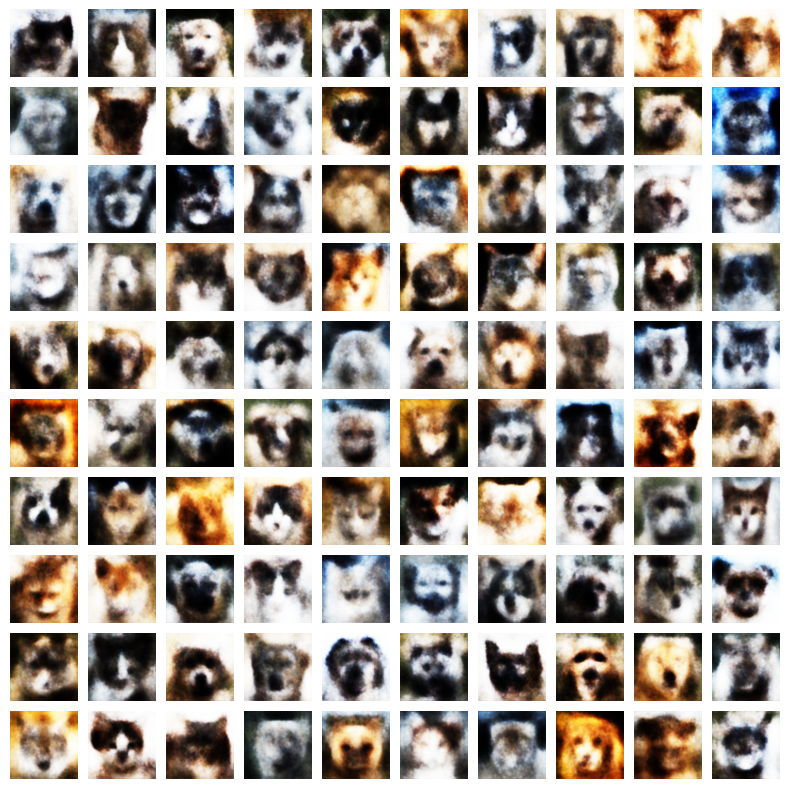

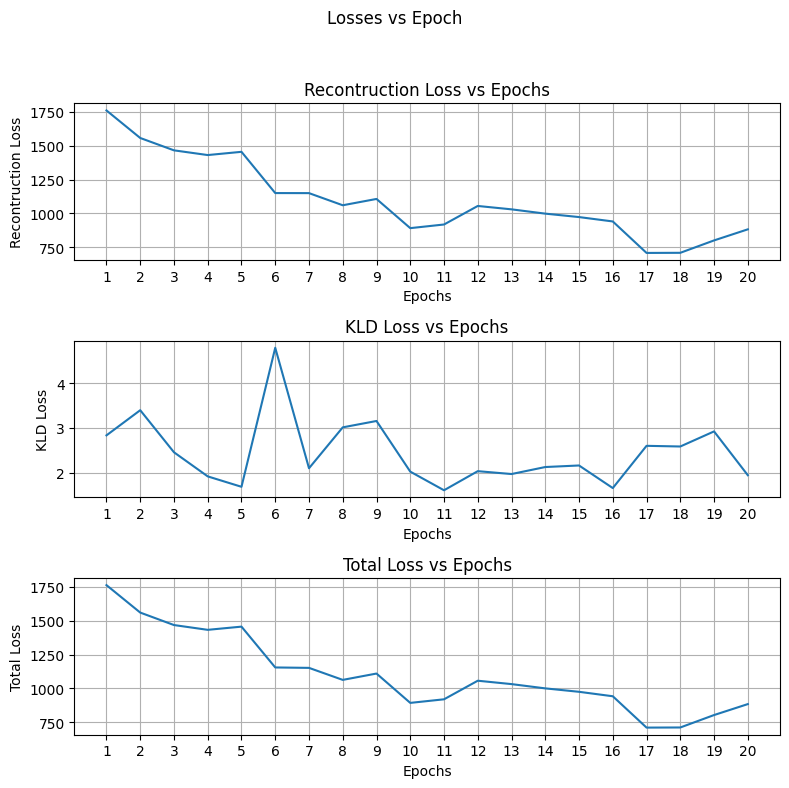

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 20, beta = 1)

plot_grid(model,latent_dim = 128, num_samples = 100)
plot_loss(Reconst_loss_list,KLD_loss_list)

#### Exp 6.3: Exp 1.1 with number of z as 50

VAE: 100%|██████████| 1613/1613 [04:25<00:00,  6.07it/s]


	Epoch: 1/20 | Rec Loss: 2296.176514 | KLD_loss: 1.939161 | Total loss: 2298.115723


VAE: 100%|██████████| 1613/1613 [04:22<00:00,  6.15it/s]


	Epoch: 2/20 | Rec Loss: 1636.360962 | KLD_loss: 5.329919 | Total loss: 1641.690918


VAE: 100%|██████████| 1613/1613 [04:23<00:00,  6.13it/s]


	Epoch: 3/20 | Rec Loss: 1395.627075 | KLD_loss: 1.778615 | Total loss: 1397.405640


VAE: 100%|██████████| 1613/1613 [04:22<00:00,  6.15it/s]


	Epoch: 4/20 | Rec Loss: 1319.785767 | KLD_loss: 3.036341 | Total loss: 1322.822144


VAE: 100%|██████████| 1613/1613 [04:15<00:00,  6.30it/s]


	Epoch: 5/20 | Rec Loss: 1195.185303 | KLD_loss: 1.969239 | Total loss: 1197.154541


VAE: 100%|██████████| 1613/1613 [04:12<00:00,  6.39it/s]


	Epoch: 6/20 | Rec Loss: 1047.193604 | KLD_loss: 2.600151 | Total loss: 1049.793701


VAE: 100%|██████████| 1613/1613 [04:18<00:00,  6.23it/s]


	Epoch: 7/20 | Rec Loss: 1276.975098 | KLD_loss: 2.369547 | Total loss: 1279.344604


VAE: 100%|██████████| 1613/1613 [04:18<00:00,  6.23it/s]


	Epoch: 8/20 | Rec Loss: 1083.289062 | KLD_loss: 2.553773 | Total loss: 1085.842896


VAE: 100%|██████████| 1613/1613 [04:18<00:00,  6.24it/s]


	Epoch: 9/20 | Rec Loss: 1015.324402 | KLD_loss: 2.077140 | Total loss: 1017.401550


VAE: 100%|██████████| 1613/1613 [04:13<00:00,  6.36it/s]


	Epoch: 10/20 | Rec Loss: 1227.932861 | KLD_loss: 2.016080 | Total loss: 1229.948975


VAE: 100%|██████████| 1613/1613 [04:12<00:00,  6.38it/s]


	Epoch: 11/20 | Rec Loss: 997.571655 | KLD_loss: 2.440454 | Total loss: 1000.012085


VAE: 100%|██████████| 1613/1613 [04:13<00:00,  6.36it/s]


	Epoch: 12/20 | Rec Loss: 936.547791 | KLD_loss: 2.602103 | Total loss: 939.149902


VAE: 100%|██████████| 1613/1613 [04:12<00:00,  6.38it/s]


	Epoch: 13/20 | Rec Loss: 855.619446 | KLD_loss: 2.273787 | Total loss: 857.893250


VAE: 100%|██████████| 1613/1613 [04:12<00:00,  6.39it/s]


	Epoch: 14/20 | Rec Loss: 800.811218 | KLD_loss: 2.231573 | Total loss: 803.042786


VAE: 100%|██████████| 1613/1613 [04:12<00:00,  6.39it/s]


	Epoch: 15/20 | Rec Loss: 829.480774 | KLD_loss: 2.280082 | Total loss: 831.760864


VAE: 100%|██████████| 1613/1613 [04:12<00:00,  6.39it/s]


	Epoch: 16/20 | Rec Loss: 948.898926 | KLD_loss: 2.324250 | Total loss: 951.223206


VAE: 100%|██████████| 1613/1613 [04:12<00:00,  6.39it/s]


	Epoch: 17/20 | Rec Loss: 698.240295 | KLD_loss: 1.952998 | Total loss: 700.193298


VAE: 100%|██████████| 1613/1613 [04:12<00:00,  6.38it/s]


	Epoch: 18/20 | Rec Loss: 730.571594 | KLD_loss: 2.011162 | Total loss: 732.582764


VAE: 100%|██████████| 1613/1613 [04:15<00:00,  6.32it/s]


	Epoch: 19/20 | Rec Loss: 898.060547 | KLD_loss: 2.205630 | Total loss: 900.266174


VAE: 100%|██████████| 1613/1613 [04:15<00:00,  6.32it/s]


	Epoch: 20/20 | Rec Loss: 872.684021 | KLD_loss: 2.835707 | Total loss: 875.519714


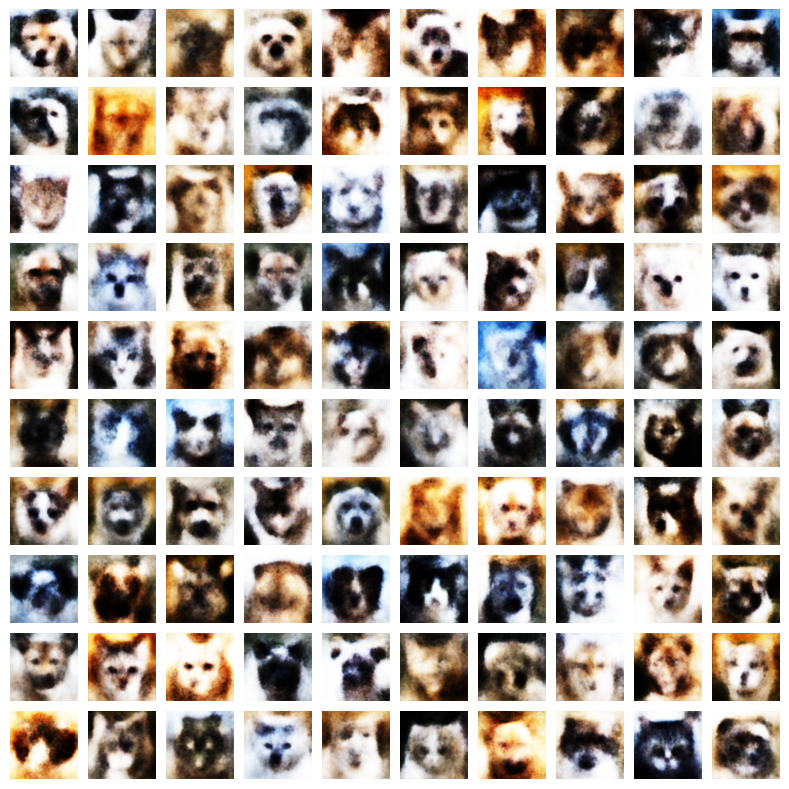

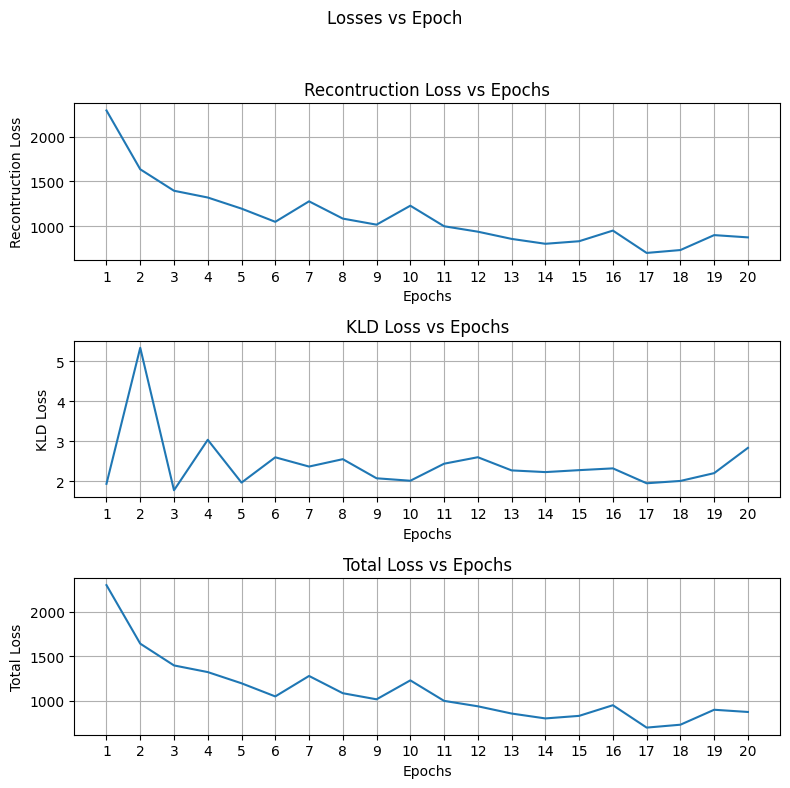

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 50, beta = 1)

plot_grid(model,latent_dim = 128, num_samples = 100)
plot_loss(Reconst_loss_list,KLD_loss_list)

# Problem3: β-VAE

# β-VAE model

- Using the already implemented VAE() class, which had a default value of beta, few experiments for different values of beta were carried out for this question.
- Following β values were tested: 0.25, 0.75, 1.5, 2.0, 4.0

## Observations:

- As the KLD term in the Loss function serves as a regularizer of the latent space, and β control the degree of regularization applied on the latent space.
  - β > 1 : Over-regularized / Underfitting / High Bias and Low Variance.
  - β = 1 : Vanilla VAE
  - β < 1 : Under-regularized / Overfitting / Low Bias and High Variance.

- As expressed above, with increasing β values, the generation of images becomes worser as $Q_{\phi}(z|x)$ almost exactly follows $P_{\theta}(z)$ leading to posterior collapse.

- With increasing β values, the reconstructed images also start getting noisier as the regularization is increased and KLD term becomes more dominant. As a consequence, the KLD loss also reduces with increasing β values.



In [ ]:
# This is again needed because last experiment was with batch_size = 10
transform = transforms.Compose(
    [
        transforms.Resize(size=128),
        #transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor()
    ]

)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
train_data = datasets.ImageFolder('/content/drive/MyDrive/ADRL Assignment/data/',transform=transform)
#train_data = datasets.ImageFolder('.\\archive\\afhq\\',transform=transform)
batch_size = 100
train_loader = DataLoader(train_data,batch_size=batch_size,shuffle=True,num_workers=2)

# Exp 7.1: β-VAE with β = 0.25

VAE: 100%|██████████| 162/162 [00:14<00:00, 11.34it/s]


	Epoch: 1/20 | Rec Loss: 2492.081543 | KLD_loss: 23.310854 | Total loss: 2497.909180


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.18it/s]


	Epoch: 2/20 | Rec Loss: 2530.918213 | KLD_loss: 15.581629 | Total loss: 2534.813721


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.26it/s]


	Epoch: 3/20 | Rec Loss: 2366.243408 | KLD_loss: 8.823369 | Total loss: 2368.449219


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.38it/s]


	Epoch: 4/20 | Rec Loss: 2434.280029 | KLD_loss: 14.395648 | Total loss: 2437.878906


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.31it/s]


	Epoch: 5/20 | Rec Loss: 1725.423950 | KLD_loss: 13.662904 | Total loss: 1728.839722


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.29it/s]


	Epoch: 6/20 | Rec Loss: 2107.041504 | KLD_loss: 9.266676 | Total loss: 2109.358154


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.28it/s]


	Epoch: 7/20 | Rec Loss: 2077.376709 | KLD_loss: 6.966907 | Total loss: 2079.118408


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 8/20 | Rec Loss: 1808.419312 | KLD_loss: 15.080389 | Total loss: 1812.189453


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.58it/s]


	Epoch: 9/20 | Rec Loss: 1649.319702 | KLD_loss: 8.111753 | Total loss: 1651.347656


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 10/20 | Rec Loss: 1553.242188 | KLD_loss: 7.861117 | Total loss: 1555.207520


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 11/20 | Rec Loss: 1822.088867 | KLD_loss: 13.765604 | Total loss: 1825.530273


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.65it/s]


	Epoch: 12/20 | Rec Loss: 1651.461304 | KLD_loss: 10.268026 | Total loss: 1654.028320


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.71it/s]


	Epoch: 13/20 | Rec Loss: 1568.892822 | KLD_loss: 12.601520 | Total loss: 1572.043213


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 14/20 | Rec Loss: 1535.581299 | KLD_loss: 8.503331 | Total loss: 1537.707153


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 15/20 | Rec Loss: 1458.984863 | KLD_loss: 8.258092 | Total loss: 1461.049438


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.69it/s]


	Epoch: 16/20 | Rec Loss: 1447.363770 | KLD_loss: 8.783999 | Total loss: 1449.559814


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.71it/s]


	Epoch: 17/20 | Rec Loss: 1567.506470 | KLD_loss: 10.323079 | Total loss: 1570.087280


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.67it/s]


	Epoch: 18/20 | Rec Loss: 1480.976318 | KLD_loss: 11.868108 | Total loss: 1483.943359


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 19/20 | Rec Loss: 1477.211426 | KLD_loss: 12.571461 | Total loss: 1480.354248


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 20/20 | Rec Loss: 1524.482300 | KLD_loss: 9.447127 | Total loss: 1526.844116


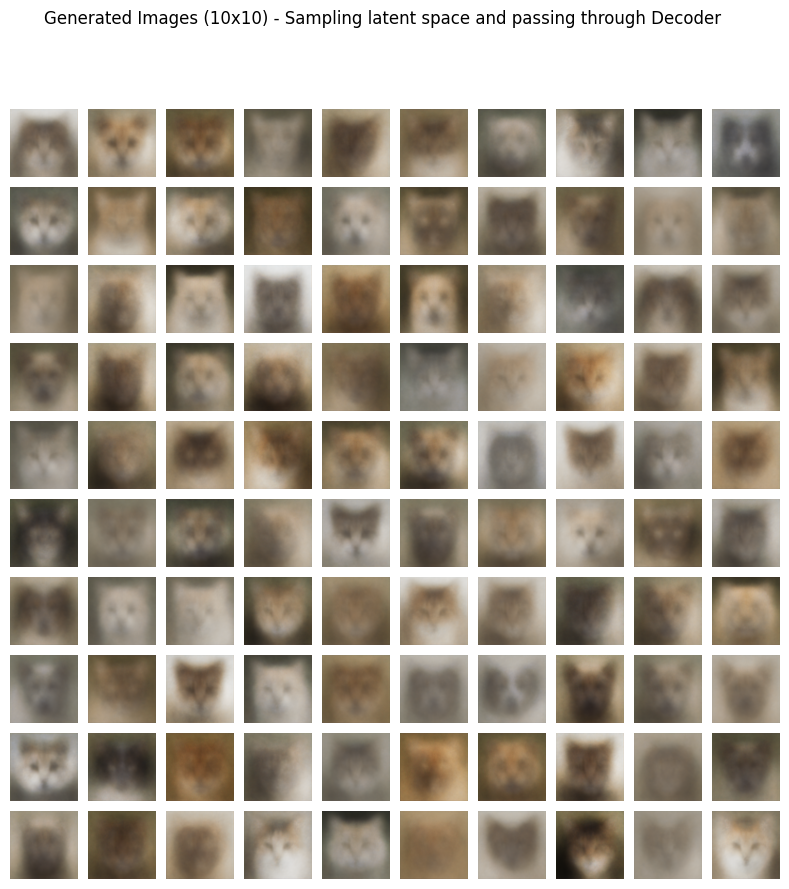

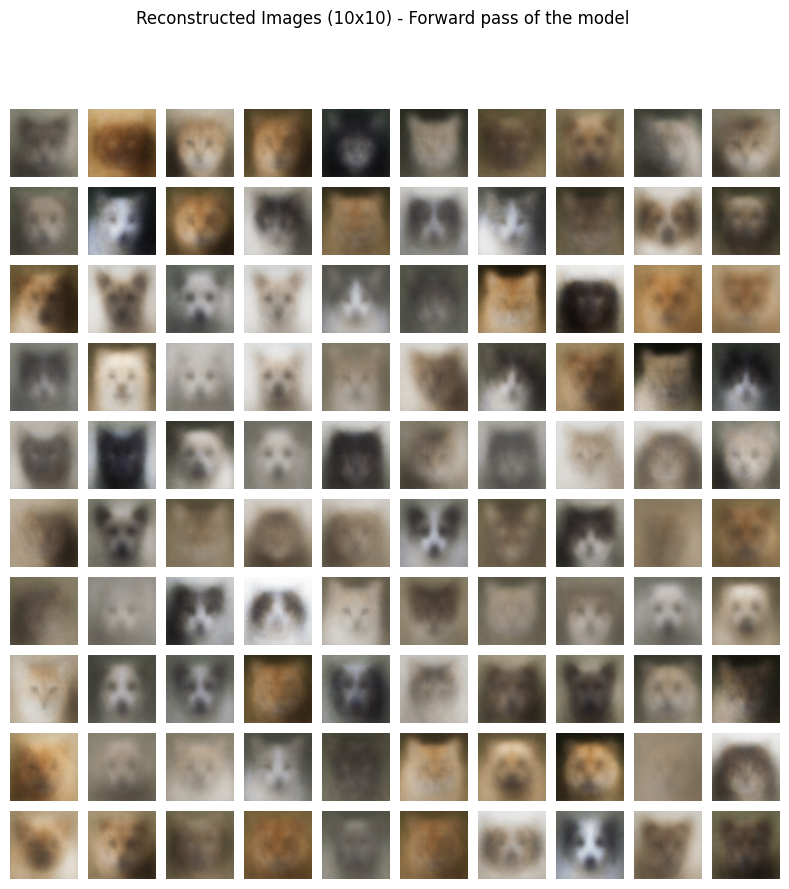

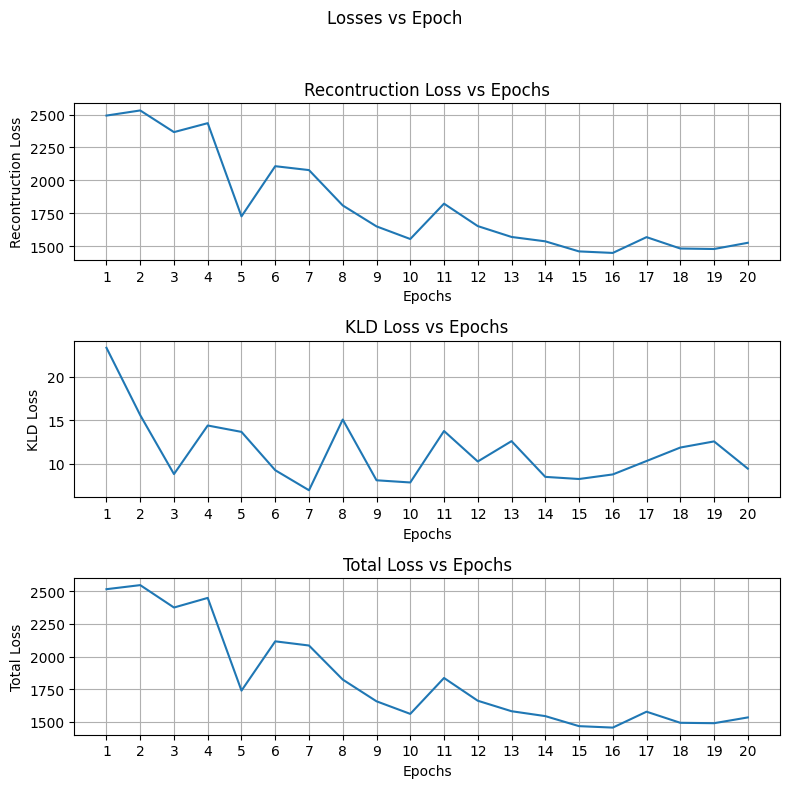

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list,KLD_loss_list = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 0.25)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list,KLD_loss_list)


# Beta-VAE with β = 0.75

VAE: 100%|██████████| 162/162 [00:11<00:00, 13.54it/s]


	Epoch: 1/20 | Rec Loss: 2689.705322 | KLD_loss: 15.583592 | Total loss: 2701.393066


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.56it/s]


	Epoch: 2/20 | Rec Loss: 2421.258545 | KLD_loss: 4.548555 | Total loss: 2424.669922


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 3/20 | Rec Loss: 2590.713623 | KLD_loss: 2.489840 | Total loss: 2592.581055


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 4/20 | Rec Loss: 2057.085449 | KLD_loss: 12.046282 | Total loss: 2066.120117


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 5/20 | Rec Loss: 1754.254028 | KLD_loss: 3.276184 | Total loss: 1756.711182


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 6/20 | Rec Loss: 1726.779053 | KLD_loss: 3.028833 | Total loss: 1729.050659


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 7/20 | Rec Loss: 2058.326172 | KLD_loss: 1.837223 | Total loss: 2059.704102


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 8/20 | Rec Loss: 2016.456665 | KLD_loss: 3.317299 | Total loss: 2018.944580


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 9/20 | Rec Loss: 1872.891479 | KLD_loss: 5.216857 | Total loss: 1876.804077


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 10/20 | Rec Loss: 1818.512573 | KLD_loss: 4.781203 | Total loss: 1822.098511


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 11/20 | Rec Loss: 1453.690186 | KLD_loss: 3.945581 | Total loss: 1456.649414


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 12/20 | Rec Loss: 1680.947998 | KLD_loss: 5.493482 | Total loss: 1685.068115


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.68it/s]


	Epoch: 13/20 | Rec Loss: 1387.805786 | KLD_loss: 3.180406 | Total loss: 1390.191040


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 14/20 | Rec Loss: 1486.453979 | KLD_loss: 3.474995 | Total loss: 1489.060181


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 15/20 | Rec Loss: 1465.385132 | KLD_loss: 5.027946 | Total loss: 1469.156128


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 16/20 | Rec Loss: 1431.885010 | KLD_loss: 3.706572 | Total loss: 1434.664917


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 17/20 | Rec Loss: 1454.212524 | KLD_loss: 4.050756 | Total loss: 1457.250610


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.58it/s]


	Epoch: 18/20 | Rec Loss: 1370.471313 | KLD_loss: 4.694263 | Total loss: 1373.992065


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 19/20 | Rec Loss: 1353.774170 | KLD_loss: 4.670577 | Total loss: 1357.277100


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 20/20 | Rec Loss: 1303.569580 | KLD_loss: 4.564887 | Total loss: 1306.993286


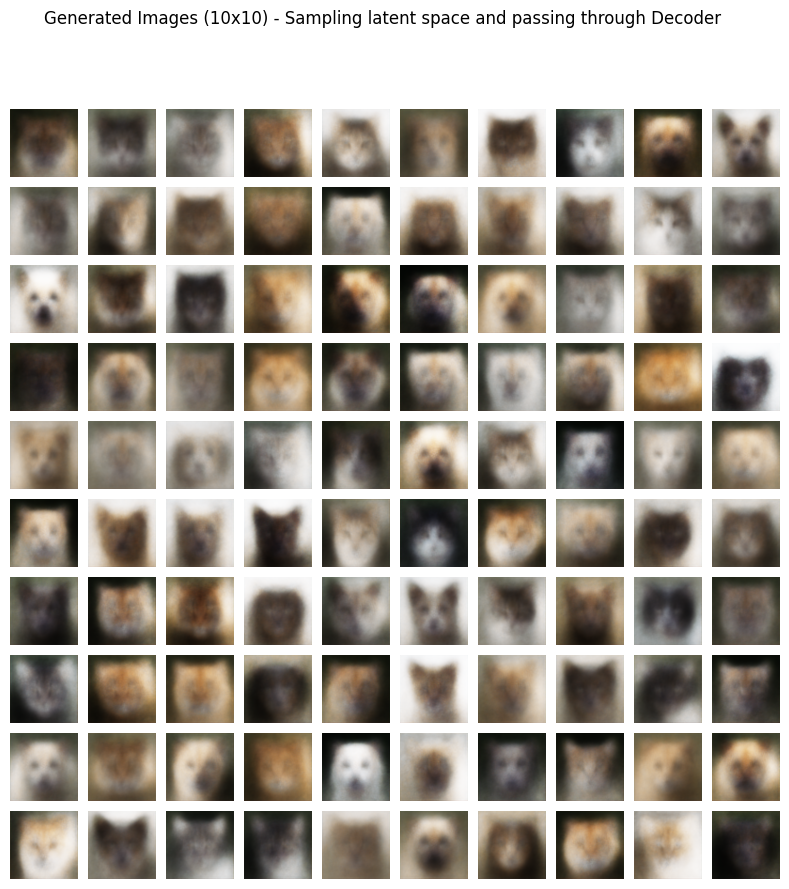

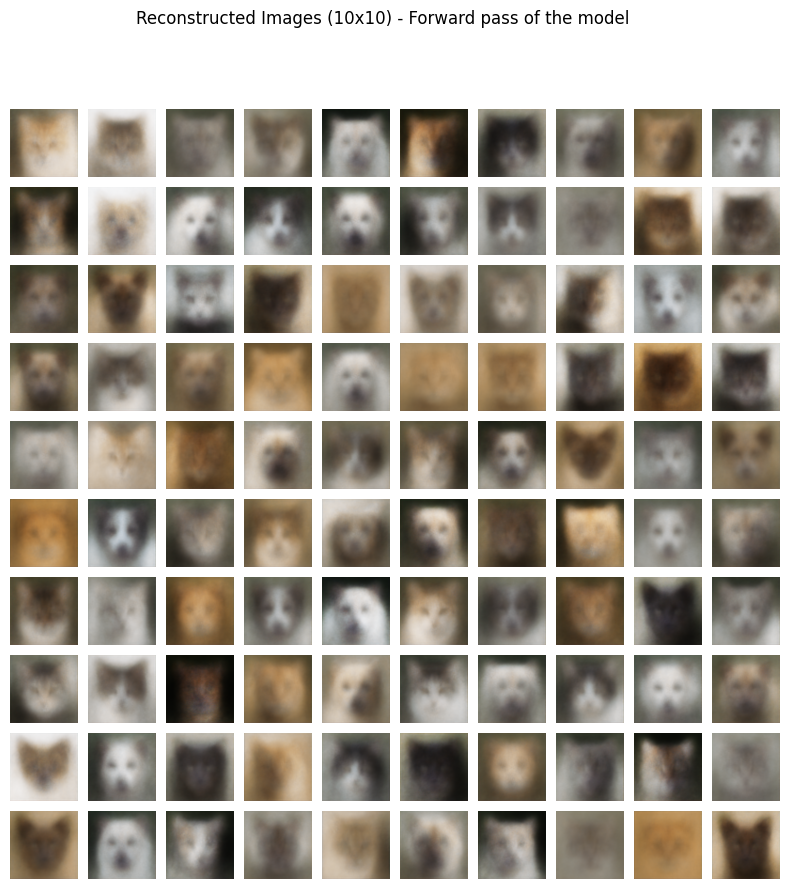

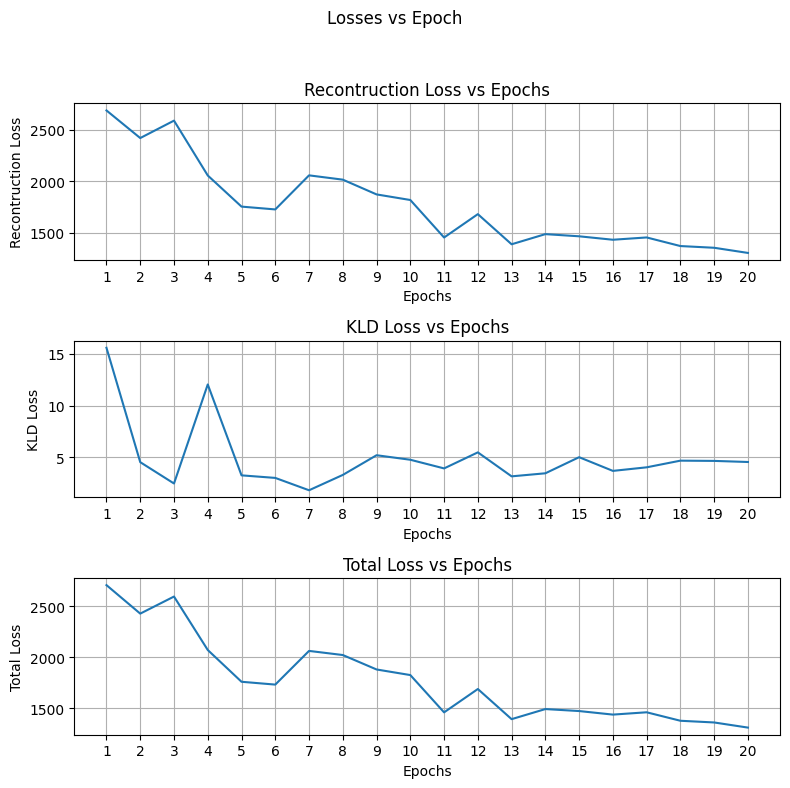

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list_0p75,KLD_loss_list_0p75 = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 0.75)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list_0p75,KLD_loss_list_0p75)

# Beta-VAE with β = 1.5

VAE: 100%|██████████| 162/162 [00:11<00:00, 13.54it/s]


	Epoch: 1/20 | Rec Loss: 2527.939209 | KLD_loss: 6.485568 | Total loss: 2537.667480


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 2/20 | Rec Loss: 2618.826660 | KLD_loss: 2.350434 | Total loss: 2622.352295


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 3/20 | Rec Loss: 2456.998535 | KLD_loss: 2.488140 | Total loss: 2460.730713


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 4/20 | Rec Loss: 2342.719971 | KLD_loss: 7.283220 | Total loss: 2353.644775


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 5/20 | Rec Loss: 2213.640625 | KLD_loss: 2.931836 | Total loss: 2218.038330


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 6/20 | Rec Loss: 1890.751099 | KLD_loss: 1.964137 | Total loss: 1893.697266


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.38it/s]


	Epoch: 7/20 | Rec Loss: 1711.475342 | KLD_loss: 1.502327 | Total loss: 1713.728882


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 8/20 | Rec Loss: 1790.197510 | KLD_loss: 2.120817 | Total loss: 1793.378784


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 9/20 | Rec Loss: 1829.661987 | KLD_loss: 2.163762 | Total loss: 1832.907593


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 10/20 | Rec Loss: 1662.319336 | KLD_loss: 2.748397 | Total loss: 1666.441895


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.47it/s]


	Epoch: 11/20 | Rec Loss: 1899.139404 | KLD_loss: 2.296227 | Total loss: 1902.583740


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 12/20 | Rec Loss: 1535.342163 | KLD_loss: 1.998606 | Total loss: 1538.340088


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 13/20 | Rec Loss: 1561.239624 | KLD_loss: 1.724655 | Total loss: 1563.826660


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 14/20 | Rec Loss: 1383.853760 | KLD_loss: 2.316099 | Total loss: 1387.327881


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 15/20 | Rec Loss: 1675.413330 | KLD_loss: 2.447735 | Total loss: 1679.084961


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.58it/s]


	Epoch: 16/20 | Rec Loss: 1552.323242 | KLD_loss: 2.134105 | Total loss: 1555.524414


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 17/20 | Rec Loss: 1525.420898 | KLD_loss: 1.611414 | Total loss: 1527.838013


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.63it/s]


	Epoch: 18/20 | Rec Loss: 1486.283325 | KLD_loss: 1.844809 | Total loss: 1489.050537


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 19/20 | Rec Loss: 1440.095337 | KLD_loss: 1.988973 | Total loss: 1443.078735


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.58it/s]


	Epoch: 20/20 | Rec Loss: 1436.100098 | KLD_loss: 1.904767 | Total loss: 1438.957275


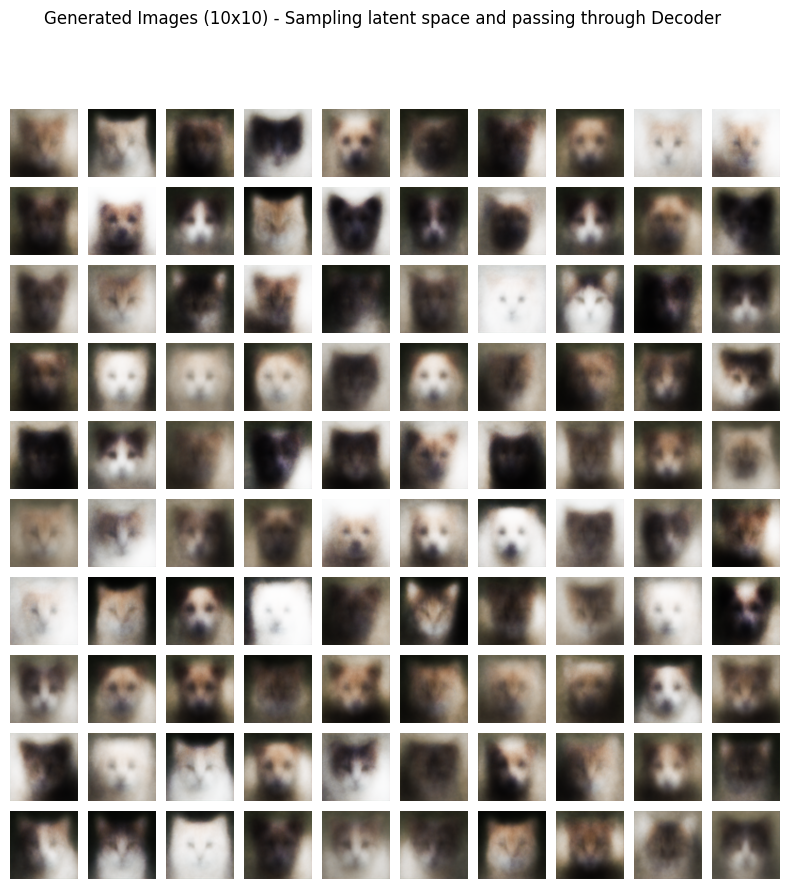

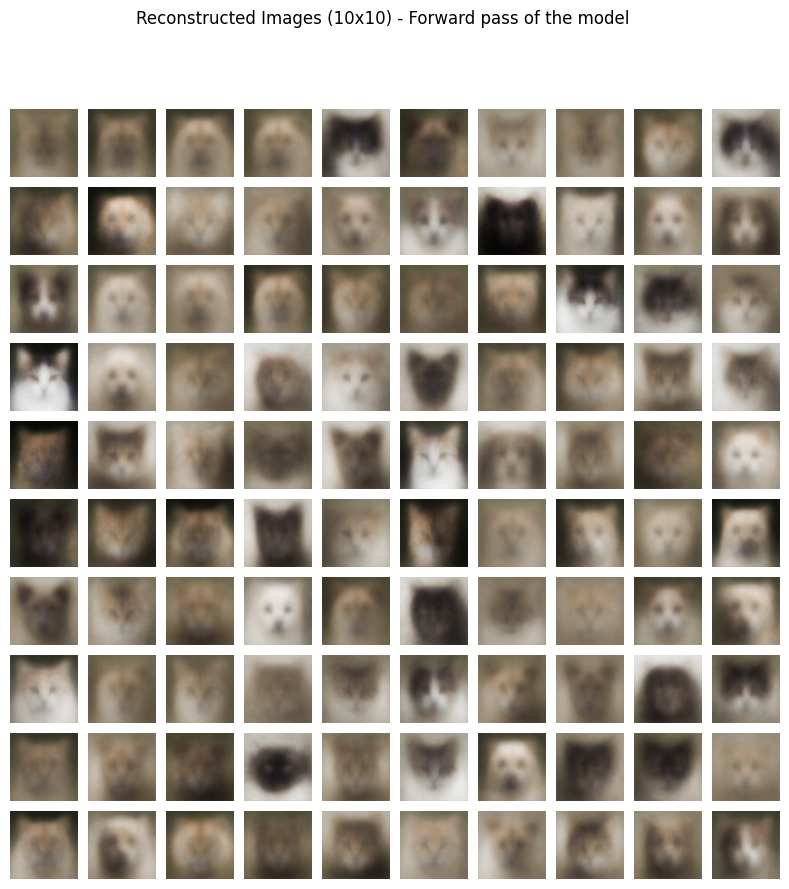

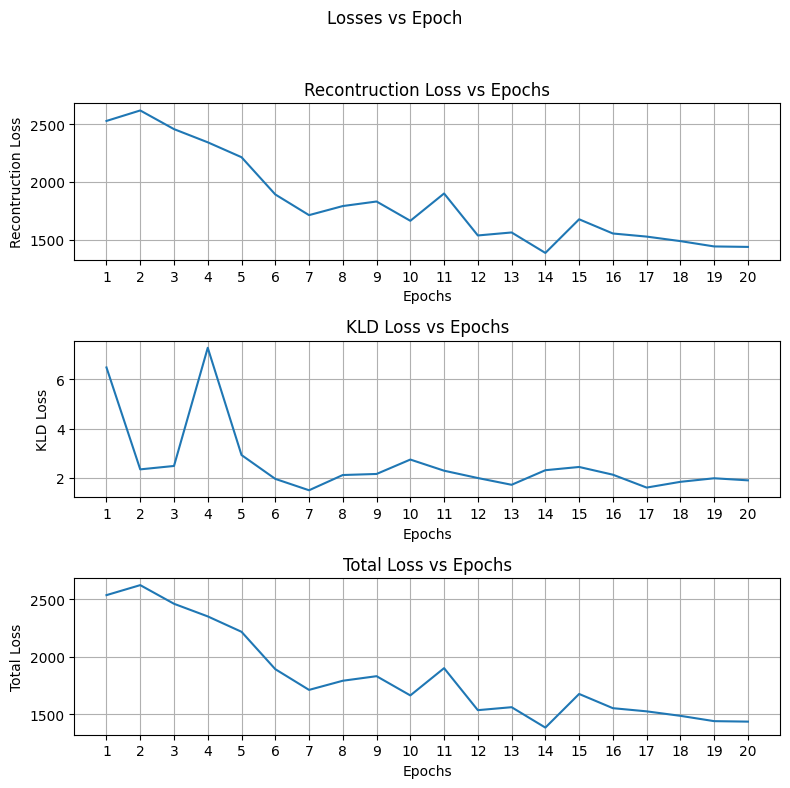

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list_1p5,KLD_loss_list_1p5 = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 1.5)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list_1p5,KLD_loss_list_1p5)

# Beta-VAE with β = 2.0

VAE: 100%|██████████| 162/162 [00:12<00:00, 13.31it/s]


	Epoch: 1/20 | Rec Loss: 2815.795898 | KLD_loss: 6.126841 | Total loss: 2828.049561


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.39it/s]


	Epoch: 2/20 | Rec Loss: 2266.680908 | KLD_loss: 2.848057 | Total loss: 2272.376953


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 3/20 | Rec Loss: 2291.054199 | KLD_loss: 1.859056 | Total loss: 2294.772217


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 4/20 | Rec Loss: 2278.690186 | KLD_loss: 1.310169 | Total loss: 2281.310547


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.59it/s]


	Epoch: 5/20 | Rec Loss: 1959.318604 | KLD_loss: 2.550759 | Total loss: 1964.420166


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.44it/s]


	Epoch: 6/20 | Rec Loss: 2145.255371 | KLD_loss: 1.751961 | Total loss: 2148.759277


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.30it/s]


	Epoch: 7/20 | Rec Loss: 2096.458008 | KLD_loss: 1.101295 | Total loss: 2098.660645


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 8/20 | Rec Loss: 1594.734741 | KLD_loss: 2.334693 | Total loss: 1599.404175


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 9/20 | Rec Loss: 2135.915771 | KLD_loss: 1.339262 | Total loss: 2138.594238


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 10/20 | Rec Loss: 1799.488892 | KLD_loss: 1.223050 | Total loss: 1801.934937


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.31it/s]


	Epoch: 11/20 | Rec Loss: 1777.354980 | KLD_loss: 2.624996 | Total loss: 1782.604980


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.37it/s]


	Epoch: 12/20 | Rec Loss: 1526.936890 | KLD_loss: 1.482214 | Total loss: 1529.901367


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.57it/s]


	Epoch: 13/20 | Rec Loss: 1726.468262 | KLD_loss: 1.371075 | Total loss: 1729.210449


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 14/20 | Rec Loss: 1465.780762 | KLD_loss: 1.406006 | Total loss: 1468.592773


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 15/20 | Rec Loss: 1638.297974 | KLD_loss: 1.588395 | Total loss: 1641.474731


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.38it/s]


	Epoch: 16/20 | Rec Loss: 1585.456299 | KLD_loss: 1.645661 | Total loss: 1588.747681


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.59it/s]


	Epoch: 17/20 | Rec Loss: 1627.645752 | KLD_loss: 1.975002 | Total loss: 1631.595703


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 18/20 | Rec Loss: 1374.191895 | KLD_loss: 1.545904 | Total loss: 1377.283691


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.42it/s]


	Epoch: 19/20 | Rec Loss: 1388.452026 | KLD_loss: 1.596444 | Total loss: 1391.644897


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 20/20 | Rec Loss: 1265.566162 | KLD_loss: 1.908691 | Total loss: 1269.383545


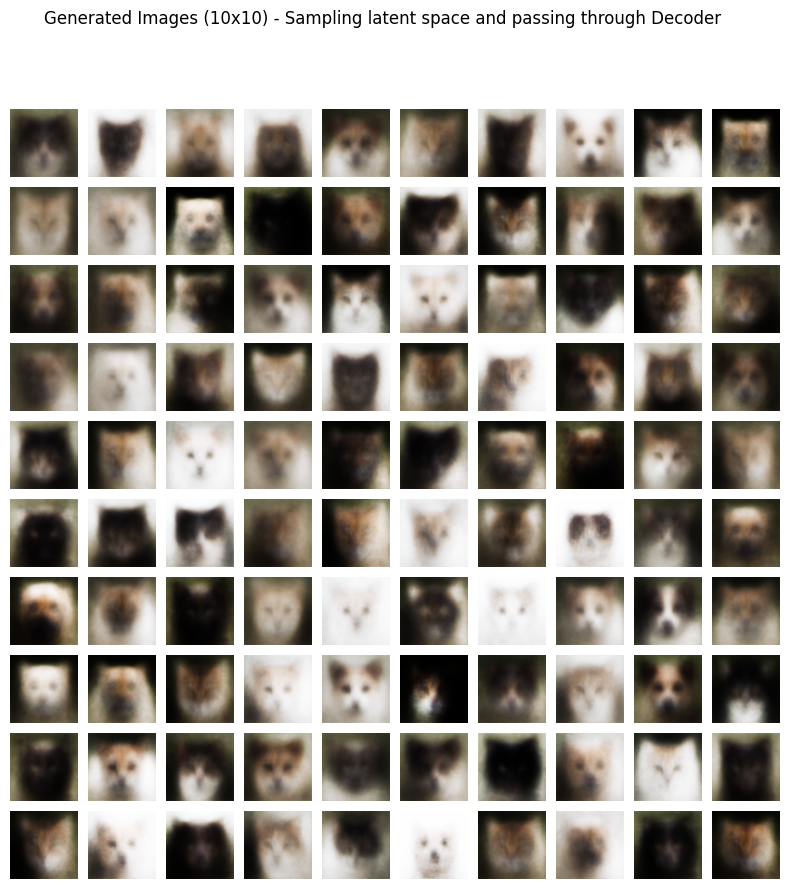

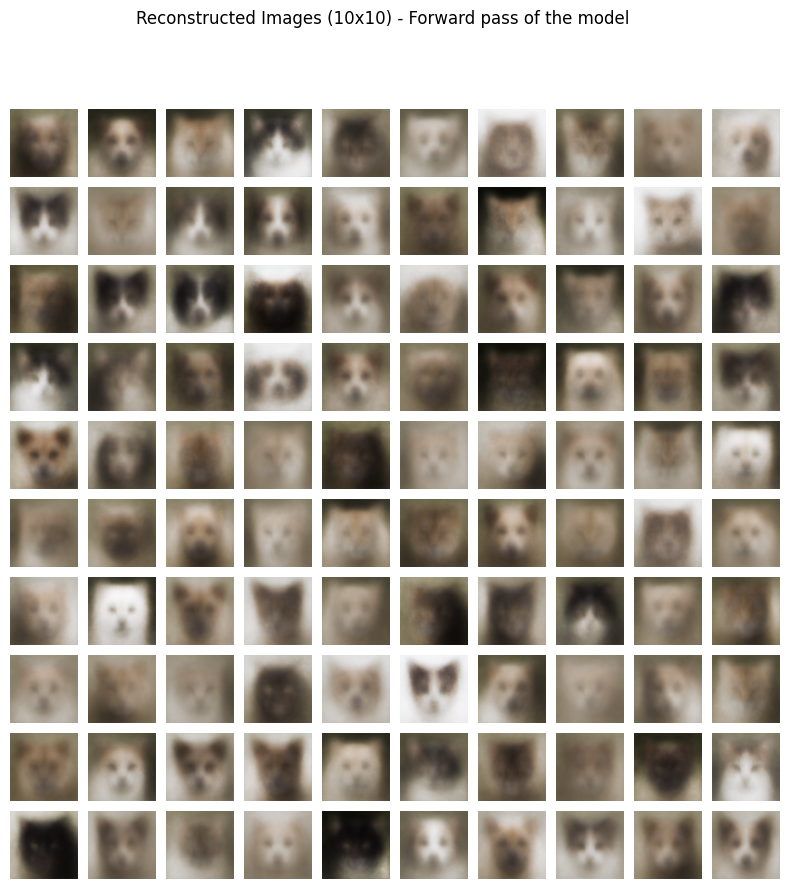

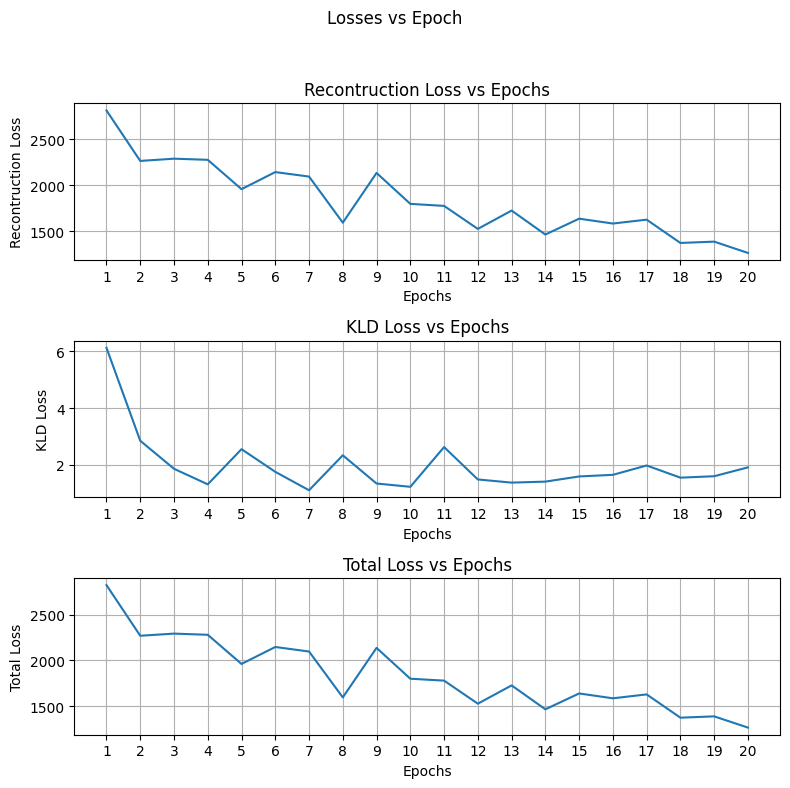

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list_2p0,KLD_loss_list_2p0 = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 2.0)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list_2p0,KLD_loss_list_2p0)

# Beta-VAE with β = 4.0

VAE: 100%|██████████| 162/162 [00:14<00:00, 11.27it/s]


	Epoch: 1/20 | Rec Loss: 2291.044434 | KLD_loss: 4.390417 | Total loss: 2308.606201


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.39it/s]


	Epoch: 2/20 | Rec Loss: 2421.698730 | KLD_loss: 1.839876 | Total loss: 2429.058350


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 3/20 | Rec Loss: 2218.824707 | KLD_loss: 0.487348 | Total loss: 2220.774170


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.51it/s]


	Epoch: 4/20 | Rec Loss: 2796.553223 | KLD_loss: 0.699550 | Total loss: 2799.351318


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.50it/s]


	Epoch: 5/20 | Rec Loss: 2132.470215 | KLD_loss: 1.516551 | Total loss: 2138.536377


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.55it/s]


	Epoch: 6/20 | Rec Loss: 1957.350342 | KLD_loss: 1.202599 | Total loss: 1962.160767


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.69it/s]


	Epoch: 7/20 | Rec Loss: 1962.982910 | KLD_loss: 1.640300 | Total loss: 1969.544067


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.59it/s]


	Epoch: 8/20 | Rec Loss: 1797.324829 | KLD_loss: 1.248996 | Total loss: 1802.320801


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.37it/s]


	Epoch: 9/20 | Rec Loss: 1464.834961 | KLD_loss: 1.425378 | Total loss: 1470.536499


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.38it/s]


	Epoch: 10/20 | Rec Loss: 1569.539062 | KLD_loss: 0.860645 | Total loss: 1572.981689


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 11/20 | Rec Loss: 1693.327881 | KLD_loss: 1.463009 | Total loss: 1699.179932


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.49it/s]


	Epoch: 12/20 | Rec Loss: 1433.668579 | KLD_loss: 1.119930 | Total loss: 1438.148315


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 13/20 | Rec Loss: 1478.165405 | KLD_loss: 1.030781 | Total loss: 1482.288574


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.48it/s]


	Epoch: 14/20 | Rec Loss: 1763.610596 | KLD_loss: 1.003306 | Total loss: 1767.623779


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 15/20 | Rec Loss: 1371.714966 | KLD_loss: 1.714241 | Total loss: 1378.571899


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.63it/s]


	Epoch: 16/20 | Rec Loss: 1484.826782 | KLD_loss: 1.374959 | Total loss: 1490.326660


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.53it/s]


	Epoch: 17/20 | Rec Loss: 1364.596436 | KLD_loss: 0.867097 | Total loss: 1368.064819


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 18/20 | Rec Loss: 1374.589111 | KLD_loss: 1.052763 | Total loss: 1378.800171


VAE: 100%|██████████| 162/162 [00:12<00:00, 13.46it/s]


	Epoch: 19/20 | Rec Loss: 1346.038574 | KLD_loss: 1.409380 | Total loss: 1351.676147


VAE: 100%|██████████| 162/162 [00:11<00:00, 13.52it/s]


	Epoch: 20/20 | Rec Loss: 1347.010864 | KLD_loss: 1.081479 | Total loss: 1351.336792


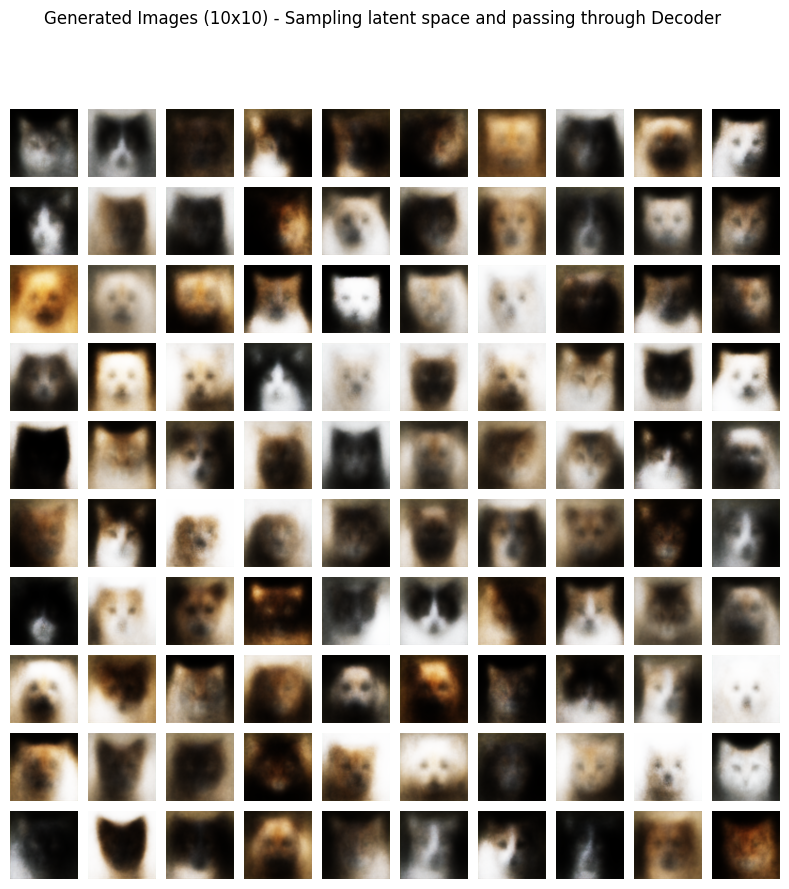

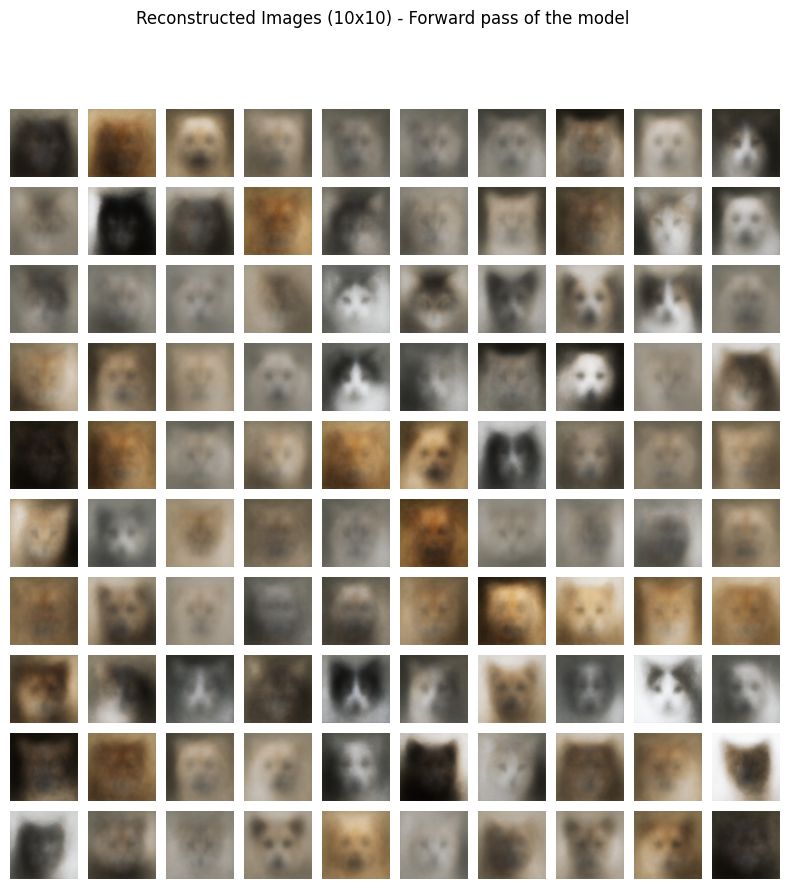

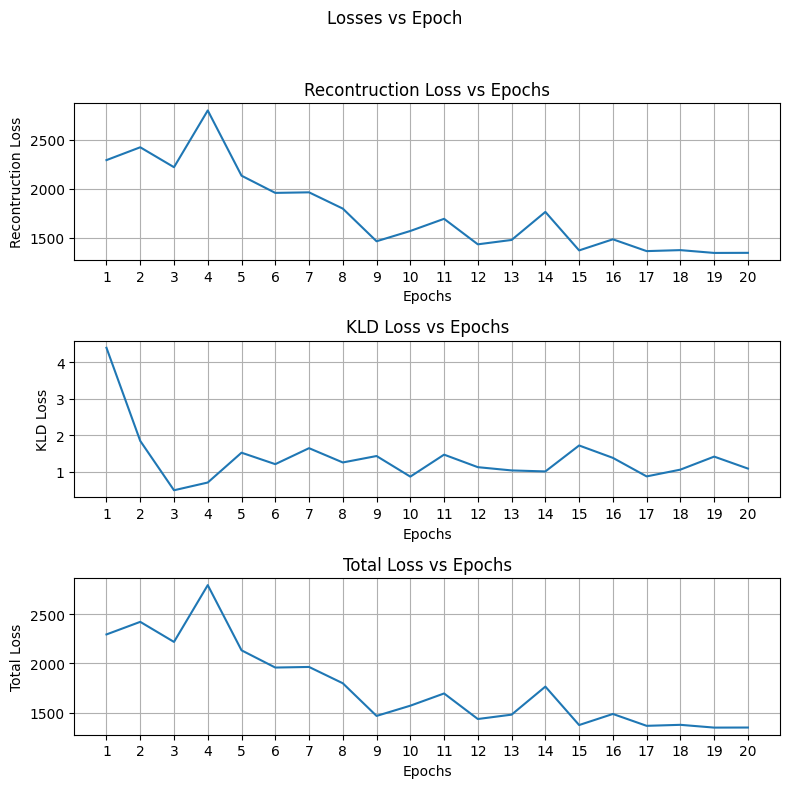

In [ ]:
model = VAE(Encoder_sel=2 ,Decoder_sel=2, input_dim = 3*128*128, hidden_dim_1 = 2048, hidden_dim_2 = 512, latent_dim = 128, device=device).to(device)
optimizer = Adam(model.parameters(), lr=1e-4)
Reconst_loss_list_4p0,KLD_loss_list_4p0 = train(model, optimizer, epochs=20, device=device, loss_type = 'MSE', reduction_type = 'sum', num_z = 1, beta = 4.0)

image,_ = next(iter(train_loader))
plot_grid(model,latent_dim = 128, num_samples = 100, x = image, plot_reconstruction = True, num_z = 1)
plot_loss(Reconst_loss_list_4p0,KLD_loss_list_4p0)